### ==========================================================================================
# PART 1: DATA PREPARATION
### ==========================================================================================

In [7]:
import os
import re
import shutil
import random
import numpy as np
from PIL import Image, ImageFilter
from winsound import Beep
from matplotlib import pyplot as plt
%matplotlib inline

### Assign directory paths for training, validation and testing sets

In [4]:
# project folder
path_project = 'E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/'

# set train, validate, and test folders
dir_train = os.path.join(path_project, '_train')
dir_valid = os.path.join(path_project, '_validate')
dir_test = os.path.join(path_project, '_test')

# directories
dirs = [dir_train, dir_valid, dir_test]

# dinamically read folders as categories, excluding files (i.e. contains ".") and train, validate and test folders when present
categories = [folder for folder in os.listdir(path_project) if not re.search(r'[\.|_]', folder)]


print('PROJECT PATH:', path_project)
print('MODEL DIRECTORIES:', dirs)
print('CATEGORIES:', categories)

PROJECT PATH: E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/
MODEL DIRECTORIES: ['E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train', 'E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate', 'E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test']
CATEGORIES: ['0', '1']


### Split data and copy images

In [5]:
def split_sets(train_percent, shuffle_data, seed, copy_resized, target_img_size):
    list_train, list_valid, list_test, sets_list = '', '', '', ''

    for category in categories:
        # get number of files in raw category folder
        files = os.listdir(os.path.join(path_project, category))
        print('Total images in category', category, ':', len(files))

        # shuffle list so files are selected at random
        if shuffle_data:
            if seed:
                random.Random(123).shuffle(files)
            else:
                random.shuffle(files)

        # set training set size in percentage. Rest will be split in two for validate and test sets
        train_size = int(np.ceil(len(files) * (train_percent/100)))
        valid_size = round((len(files) - train_size) / 2)

        # assing files to each set
        list_train = files[0: train_size]
        list_valid = files[train_size: train_size + valid_size]
        list_test = files[train_size + valid_size: len(files) + 1]
        sets_list = [list_train, list_valid, list_test]  # must follow same order as in dirs list: [dir_train, dir_valid, dir_test]

        # check that no files are duplicated in multiple sets
        if len(set(list_test).intersection(list_valid, list_train)) == 0:
            print(f'Train ({len(list_train)}), Test ({len(list_valid)}), and Validate ({len(list_test)}) sets created successfully.')

            # copy files to subfolders
            for i, dir in enumerate(dirs):
                # create directories if they do not exist
                if not os.path.exists(os.path.join(dir, category)):
                    os.makedirs(os.path.join(dir, category))

                print('---> Copying files to:', dir + '/' + category)
                for file in sets_list[i]:
                    print(category, '->', dir.split('\\')[-1], '->', file)
                    try:
                        if copy_resized:
                            img = Image.open(os.path.join(path_project, category, file))
                            img.thumbnail(target_img_size, Image.ANTIALIAS)
                            img = img.filter(ImageFilter.SHARPEN)  # optional
                            img.save(os.path.join(dir_test, category, file), "JPEG")
                        else:
                            shutil.copyfile(os.path.join(path_project, category, file), os.path.join(dir, category, file))
                    except:
                        pass

        else:
            print('Error: Duplicates found across sets!')

    print('\nData split and copying completed.')
    Beep(500, 500)


split_sets(train_percent=80, shuffle_data=True, seed=True, copy_resized=False, target_img_size=[50,50])

Total images in category 0 : 198738
Train (158991), Test (19874), and Validate (19873) sets created successfully.
---> Copying files to: E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train/0
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1451_y701_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x901_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x451_y1_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x3001_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1101_y701_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x751_y951_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2551_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1451_y851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x851_y1301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1701_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x501_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1601_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x51_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2051_y1951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1851_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1951_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x801_y851_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1901_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2051_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1801_y301_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2601_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1051_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1701_y2551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x851_y1101_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2051_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x851_y501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x301_y2601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x101_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1051_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1351_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2201_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1051_y2051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x951_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2601_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2251_y1951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x1401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2351_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1751_y2551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x401_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2001_y1151_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1001_y201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x3201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1701_y551_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x451_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2601_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x451_y751_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2501_y1401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2051_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3251_y751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2951_y2401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x551_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x3101_y1901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2951_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x451_y1501_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1251_y401_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x901_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x951_y1101_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2851_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x251_y2151_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3551_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x801_y1151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1551_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2351_y701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2601_y2251_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2401_y901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x751_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2501_y551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x3001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2751_y2501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2601_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x701_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1501_y2401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1851_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x301_y51_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x951_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2651_y2251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2151_y751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x751_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x2051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2001_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1601_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2601_y751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2301_y1351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x701_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2801_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1801_y901_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2851_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x551_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x751_y1851_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x3001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x3101_y151_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1001_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1801_y1201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2301_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1851_y1601_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2201_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x601_y1401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x3401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x701_y1901_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3501_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1951_y401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2951_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1051_y1101_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3151_y1751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x51_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x3951_y1051_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1951_y1001_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x751_y1351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3451_y1351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1601_y2351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x3051_y2251_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1351_y401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x3101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1851_y1701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3351_y601_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x751_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2551_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1301_y1301_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1451_y551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2751_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x601_y1351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1901_y951_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x2251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x3001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x3151_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2551_y351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1501_y801_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2101_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x1101_y1_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x701_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2901_y1851_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2751_y1_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3051_y1001_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1351_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x551_y1301_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1701_y1451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x3051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1501_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1451_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1151_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1651_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1601_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9175_idx5_x2001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2001_y551_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x451_y1051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x2501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2601_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1151_y451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x751_y601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x451_y1401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1101_y851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2501_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2151_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3301_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2401_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1651_y1801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3251_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2251_y951_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1951_y201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3301_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2401_y1051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1351_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3001_y251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x501_y251_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1551_y1801_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2101_y301_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2651_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1951_y701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x1001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3201_y1701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x451_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1551_y1051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2151_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1301_y1551_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2751_y2451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x51_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2751_y201_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x2201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x501_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y1901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1501_y1651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1951_y1851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1251_y101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2901_y701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1451_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1301_y451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x2201_y2051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x901_y1601_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3351_y301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2401_y2001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x3001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2301_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x3101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1851_y2201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1101_y951_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3301_y751_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2301_y801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x801_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1901_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1651_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x651_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1851_y151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x751_y401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2451_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x3101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1551_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1101_y151_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x951_y801_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3151_y2451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1251_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x651_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2051_y1_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x3001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x2401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x301_y451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x3201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x501_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2201_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x501_y551_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x751_y1201_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1951_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x401_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3351_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1101_y1101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1451_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2651_y2401_clas

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2751_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1651_y651_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1301_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3001_y1801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2051_y601_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x651_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1901_y1101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2401_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x51_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x351_y551_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2151_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1801_y101_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x651_y2351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1251_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3001_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1451_y501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1101_y2251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x901_y2401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x851_y751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1001_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1501_y901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1601_y1051_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2501_y151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2751_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x3051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x501_y1201_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2851_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2851_y951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3001_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1701_y651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1301_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x1901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1201_y1801_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2901_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1401_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2851_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x3601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1751_y1951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x551_y851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1101_y501_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2201_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2501_y451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2501_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x451_y1751_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x501_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1351_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2601_y751_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2501_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1551_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1551_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2701_y951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2551_y551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x201_y1401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x351_y651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2001_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2051_y401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2101_y1951_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1751_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x501_y1401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2001_y2051_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x51_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x951_y601_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2801_y2301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1751_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2951_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x901_y901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2551_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2651_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1151_y1051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1751_y551_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1351_y1551_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2051_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x351_y551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1051_y1601_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x451_y851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3001_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1201_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2451_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x301_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x3051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2251_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1151_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3051_y1351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2151_y1401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2551_y1501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x551_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x601_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x3001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2051_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2401_y1001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x651_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x3051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2951_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x751_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x951_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1001_y501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x851_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x951_y801_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x51_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x551_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1151_y901_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x701_y401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1751_y1601_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3101_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2001_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x51_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1801_y801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1051_y351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x3051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x251_y1901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x551_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2001_y401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1401_y1401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1551_y401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2151_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x51_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1851_y1351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x3001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1401_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16534_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1701_y2201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x501_y2151_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2251_y1051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1701_y1501_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1501_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9175_idx5_x3451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1551_y2151_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1901_y1201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x3051_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x851_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1401_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1151_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2051_y1251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x2551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2151_y2301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2401_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x501_y701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1151_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2051_y1151_clas

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1001_y2051_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1251_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1751_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1701_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1101_y1101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2901_y751_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x951_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x1601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1351_y2051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1401_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1101_y1051_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1251_y1251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16534_idx5_x351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x3001_y2651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x51_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1951_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1851_y2101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1101_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1301_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1051_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1551_y201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y351_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2051_y1501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x51_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1851_y1301_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2001_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1151_y1101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x51_y701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2801_y1251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x901_y351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2951_y2051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x3251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x3151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x701_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2801_y2301_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1051_y1951_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1751_y551_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x151_y1201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1101_y1151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x3001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1851_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1001_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1001_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2001_y1601_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x951_y2701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x3101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x2851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x51_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2701_y1801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x851_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2301_y2001_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2151_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1951_y601_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x1051_y901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y701_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x701_y551_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x51_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2201_y1201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2351_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x401_y251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x451_y801_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2151_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2201_y201_cl

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1651_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x3001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x601_y501_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1001_y1701_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x901_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1701_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1401_y951_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1251_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x251_y1751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x3201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1301_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2051_y1401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x701_y1201_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2751_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2251_y801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x501_y801_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2201_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1751_y301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1551_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1101_y2401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3501_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2051_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x601_y1301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2351_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2501_y2501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1601_y951_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3001_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x551_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x201_y1801_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2751_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x451_y1901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x551_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2051_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1851_y251_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1051_y1651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x751_y1901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3351_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1701_y1401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x101_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x51_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1751_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1001_y951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1151_y2001_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1751_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2051_y2151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2001_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x3001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1351_y1_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1451_y301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1151_y2101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2051_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x3301_y801_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x251_y551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2751_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1551_y2651_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x451_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1301_y2851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1701_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x901_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x701_y751_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1651_y1701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2151_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2001_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x551_y901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1801_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1351_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3551_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1751_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2501_y2201_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1251_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1251_y651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x401_y1251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1001_y1001_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1251_y1851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1051_y1351_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x451_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x301_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1151_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2051_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x901_y1501_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2301_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1151_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1401_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x651_y701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x3101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1451_y1251_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2451_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2351_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2251_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1201_y1301_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x651_y1251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x3051_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x951_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1101_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1251_y601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x2351_y851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x2001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x401_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2001_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x401_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x551_y1301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3201_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2401_y1051_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1651_y501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x351_y701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x951_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2951_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1051_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1101_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x51_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x951_y1351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2751_y901_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x151_y601_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2651_y2501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1851_y401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2051_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x1151_y701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1951_y1851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1351_y2251_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1651_y2251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1401_y301_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x951_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2901_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x851_y701_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1701_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x3101_y901_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2001_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x51_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x601_y801_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x2401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x51_y651_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2701_y1551_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x3001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x2351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x901_y1351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3151_y1651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x301_y2151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1201_y51_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x3401_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x3101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1151_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x3051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x451_y1451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2301_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2801_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x101_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x901_y1451_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x651_y1951_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2301_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2151_y2651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1201_y551_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x251_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x951_y2351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x901_y1851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2401_y451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2201_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2601_y851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1651_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2701_y801_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x51_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x651_y301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2851_y1051_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1351_y1101_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2651_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3201_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x251_y1251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x651_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2151_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2901_y1551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1701_y401_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x2301_y1351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3001_y1901_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3551_y1051_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1051_y1251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2851_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2051_y1501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1051_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x451_y1001_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x3051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1801_y2151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x951_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1551_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1401_y1551_clas

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x251_y751_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x701_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x501_y1201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2251_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3151_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2951_y1151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2751_y801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1651_y551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x751_y1201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x2001_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1201_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1551_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3051_y2501_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1451_y1051_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y1201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1351_y1851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2301_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x401_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1701_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1451_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x51_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1151_y901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x51_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2251_y1651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1651_y301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1101_y201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2051_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2451_y1351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1501_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3051_y1451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1651_y1051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x501_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2651_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x601_y1101_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1451_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1451_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x401_y1901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2651_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1601_y201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2401_y1301_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x2201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x551_y1151_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1651_y101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x3251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x1001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x951_y1951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2401_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1151_y551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2951_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1251_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x3001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1001_y1551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2401_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1101_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1801_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x501_y801_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1501_y1301_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1051_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x501_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1301_y2151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x2851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2951_y401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x801_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3001_y551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x151_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x401_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2651_y1751_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1501_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1551_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3001_y1751_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2701_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2051_y301_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1951_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2501_y251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3101_y1251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3351_y1951_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1751_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2451_y2351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1051_y1001_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x851_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x551_y1851_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x451_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x501_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1251_y2701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x701_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2401_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2101_y2051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2751_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1401_y701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3901_y401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1001_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x2301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x751_y951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2001_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3051_y2401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2651_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1601_y1501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1201_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1601_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3601_y451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x3001_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1401_y901_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1051_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x151_y1301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x801_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1451_y1251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x3251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x451_y501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x601_y451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2251_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2601_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x1251_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1401_y2001_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1301_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x3251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1151_y1851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1301_y1001_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2601_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x751_y2001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1701_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2851_y151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2901_y1451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x451_y2051_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1401_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x451_y601_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3001_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2551_y2901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x551_y1051_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1001_y2201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1701_y1351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2651_y351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1501_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1151_y1601_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x3051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1651_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2951_y1001_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1101_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1201_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2101_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1701_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x401_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1051_y2051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2501_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2451_y1601_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x501_y1901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3401_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2901_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1851_y2651_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x651_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2001_y1101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x301_y1601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x801_y1051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1751_y601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1951_y601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1101_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1501_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3401_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x951_y351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3451_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2701_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x201_y2001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2601_y1851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x601_y501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1251_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1951_y1201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x601_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1101_y1601_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2551_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x451_y451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x2851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2251_y1201_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x701_y1301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x851_y2051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1651_y1701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2151_y601_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x251_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3001_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1901_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x401_y1351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1401_y1851_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2201_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3301_y401_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x201_y801_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3151_y1251_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1401_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2351_y1401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x701_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x3201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1601_y2351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1851_y951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2951_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x51_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1901_y1151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3051_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x3001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2051_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x351_y1951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2801_y1451_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1701_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1651_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1651_y1851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2101_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x751_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x701_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1401_y301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3001_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x651_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x451_y1901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3251_y1051_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x2351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2151_y151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3201_y701_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x901_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y1451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2151_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x851_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x901_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1851_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1801_y1551_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x3001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x801_y851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2601_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1201_y751_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x201_y951_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1201_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1251_y801_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x701_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x3151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x951_y1101_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1451_y651_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3551_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3551_y1401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1001_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x901_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3651_y201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2651_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2951_y2401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1701_y1901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x1001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3501_y1201_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3201_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x701_y2551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x3101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2001_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2651_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2651_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x701_y2101_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1651_y351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2451_y1001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1051_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2001_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2301_y1751_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2601_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x401_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2801_y2101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1051_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1901_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1051_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x251_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2301_y1651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2651_y1851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1701_y1201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x3201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2151_y1501_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x501_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1551_y1801_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x201_y701_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x351_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1551_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x851_y651_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x151_y901_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1151_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1951_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1901_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x401_y1351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x501_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x851_y1601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3101_y2551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x951_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2451_y851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2051_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1901_y2101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2101_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1751_y2251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3251_y1801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x701_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x201_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x701_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1351_y701_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1551_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2451_y2051_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x901_y951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x901_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1901_y2001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1251_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x701_y751_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1301_y2351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1751_y2001_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1051_y1701_clas

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1001_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x901_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x101_y1651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2701_y2101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x401_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x401_y751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x3201_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x901_y1951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1051_y1701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x51_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x2101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x3001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1001_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1601_y1651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x451_y551_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x51_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2251_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x501_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x601_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1551_y2251_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x601_y351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2501_y1901_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x3301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1351_y2051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x401_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x601_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x51_y2851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1751_y251_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x551_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x251_y651_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x801_y401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1551_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x3251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1651_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x451_y301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1451_y1601_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x2851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1501_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x701_y1001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x3001_y1651_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1101_y1151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3701_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2201_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x751_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2551_y1101_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x51_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1301_y2701_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1751_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1251_y2051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2851_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1301_y151_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1001_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2701_y2701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2551_y351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3251_y1051_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x1551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1751_y2151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1051_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1351_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2751_y2951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2801_y2051_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1651_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2151_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1501_y301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x601_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1251_y1851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2051_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2301_y951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x4001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x301_y751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x3101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2301_y2001_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2051_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2701_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1051_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x751_y151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1001_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2501_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1801_y1851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2551_y1201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x3101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1051_y1401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1401_y1901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2001_y451_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x3001_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1351_y501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2851_y201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x301_y801_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1301_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2201_y1901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x401_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x2351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x551_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1801_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2601_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1751_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1901_y1151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1501_y1_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1901_y1201_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x751_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3251_y1201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2451_y351_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1201_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1851_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x3101_y51_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x401_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x951_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1251_y651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x401_y801_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1301_y1701_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1201_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x701_y401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1201_y701_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2151_y201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1451_y1801_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x3201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1951_y1801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1001_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x851_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2051_y1401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2051_y1801_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2051_y1401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2201_y751_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1851_y451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x51_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1001_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2551_y2001_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x801_y2451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x2051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x951_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3101_y1801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x651_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3001_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x3101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2901_y2501_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3251_y751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2151_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1001_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2801_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y2851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1051_y1751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1351_y2001_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1801_y1651_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x2201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x951_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2701_y1751_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2151_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1751_y2951_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x501_y1001_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1401_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x251_y1_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x51_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x751_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1001_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1001_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2301_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1751_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x701_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2501_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1401_y1901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1551_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x3101_y1651_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x2901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1101_y2201_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2251_y1001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1051_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x401_y1651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x1101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1651_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2251_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x801_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2401_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2501_y1651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1551_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x601_y1751_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x2801_y51_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1301_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1251_y1201_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x851_y1701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x801_y1751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1451_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x301_y2751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1001_y1651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1201_y2451_clas

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x51_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2401_y1001_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2501_y1801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x601_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2001_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1601_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1651_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1001_y1001_clas

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x751_y1001_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x801_y401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2801_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2351_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2401_y101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1201_y351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x3051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x3101_y1301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2101_y351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x701_y1301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1051_y951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2251_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2551_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1651_y1401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x451_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1851_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2751_y2151_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2251_y2001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1701_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1101_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1451_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1651_y251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1001_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x1401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1751_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x1051_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2801_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x3101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1851_y1051_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1251_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x2601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1701_y1551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x3001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x651_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3301_y2551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x51_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x251_y151_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x751_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x451_y501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2401_y1301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x51_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x501_y601_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x3851_y1351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x3151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2251_y601_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1001_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x201_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x851_y2001_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2201_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2001_y1851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1851_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x551_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x851_y1301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2551_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x51_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2651_y151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x751_y2101_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x801_y1001_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1251_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x651_y651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x701_y701_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2251_y2051_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1051_y301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x951_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1201_y401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3001_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1651_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2151_y1451_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2351_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1401_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x601_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x501_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x3001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x51_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x501_y2351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x451_y1351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x801_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1301_y951_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1251_y1351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2651_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x651_y201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1951_y801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2051_y801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2751_y251_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1351_y1601_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x651_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2551_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2351_y701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3201_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x351_y1501_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1901_y501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x151_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x3001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x951_y1951_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x551_y2451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x901_y101_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x3251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x951_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x1501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x501_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2001_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x101_y451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2801_y2301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2001_y1651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2401_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y1851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1251_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1501_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1051_y851_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1951_y151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1301_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1951_y351_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1551_y1601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x2701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x651_y401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2301_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2701_y2451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2351_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1151_y1001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3601_y1401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2551_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1301_y1951_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x201_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2301_y351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x951_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x51_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1751_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1701_y701_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3551_y901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2701_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1201_y1351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2301_y1801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1601_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1351_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2001_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1251_y201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x451_y201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3051_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x151_y501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x301_y1601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3401_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2101_y1851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1401_y1301_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x751_y2101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x951_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2051_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x501_y1101_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2101_y2301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1051_y851_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x851_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x551_y1651_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2451_y2101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1201_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x3101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1251_y501_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2351_y1201_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1451_y1701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2351_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x501_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x51_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x951_y801_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1001_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1501_y1551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1701_y1551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1651_y201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1001_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2651_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x3001_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2151_y1851_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2251_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1101_y1451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x51_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1151_y1251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2001_y501_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1901_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x301_y1651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2501_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1051_y2101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x451_y2201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x951_y701_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2151_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1001_y1151_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x3001_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x2601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2101_y1751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x2151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1001_y1751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x901_y351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1501_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3101_y2501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2201_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2351_y1201_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1301_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x251_y851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2351_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x3051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2151_y1551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2001_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x901_y201_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x801_y1301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1351_y1351_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1701_y2051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x301_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1651_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x3001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2101_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2351_y1351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2101_y301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1651_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1751_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x401_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1551_y2601_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1251_y251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x3251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1251_y151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x1151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1151_y401_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x601_y1551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1851_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x901_y451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x451_y751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x3351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1151_y851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1451_y801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x51_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1851_y2001_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x451_y2451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x401_y1551_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2301_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x51_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2501_y1451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x101_y551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1001_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x751_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x651_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2051_y201_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2501_y151_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x701_y451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x401_y1851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1651_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1101_y1351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1551_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2051_y1451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1651_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x51_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x701_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1301_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2451_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1301_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2151_y1651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x651_y1901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x2151_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3301_y751_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x901_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1101_y701_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x501_y1701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1601_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1001_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1701_y1751_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x751_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2651_y1201_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x451_y1951_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2001_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1251_y801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2001_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1551_y101_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2001_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y1651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x2051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x951_y401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2051_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3401_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x601_y401_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1201_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x401_y1401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2551_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1051_y1851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1201_y451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3301_y2501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x801_y351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1901_y1751_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1851_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1151_y451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x3101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2251_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2201_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x3101_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1801_y801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2801_y201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x651_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x201_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1201_y151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2451_y1051_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2101_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x2751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1151_y1751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3801_y901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1351_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3051_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1501_y251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2151_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3201_y1101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1951_y1601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1201_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x551_y1101_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1051_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x451_y1251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2901_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1601_y2901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2401_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x51_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x851_y1251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1951_y1751_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2951_y1951_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3051_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1801_y551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x3001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1251_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x701_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2101_y451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1251_y1701_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x3001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1301_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1051_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3051_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x3301_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x901_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2001_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2501_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1651_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x451_y151_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2701_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1601_y1651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x851_y1101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x3051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3051_y451_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3601_y1201_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x3301_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2801_y1351_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x3001_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1801_y1401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x951_y2401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x801_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1851_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2051_y2051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2601_y1201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2401_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x801_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x4001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2301_y1501_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1201_y951_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x2851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x201_y1001_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1151_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x51_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2351_y1251_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1651_y1701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3901_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1051_y951_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1151_y551_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x1801_y51_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x101_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2301_y1501_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1501_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2851_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2301_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2901_y901_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x751_y2401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x801_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1601_y1151_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3251_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2301_y2351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2201_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1651_y2301_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2801_y1901_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2801_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x551_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y951_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x701_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1851_y351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1751_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1901_y1351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2601_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1501_y1001_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x51_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x551_y551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3351_y1251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1951_y951_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1901_y1251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x201_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x851_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2251_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x3201_y1101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x951_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1851_y201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x551_y251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x301_y601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1701_y1951_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1051_y751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2301_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x901_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1951_y801_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1201_y301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3251_y1451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1651_y1801_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x451_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x701_y1351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x801_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2301_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1351_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x451_y901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x951_y1351_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3051_y1651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x351_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3101_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1001_y551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3101_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x2151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x901_y1651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1551_y851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2001_y1201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x3051_y601_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x801_y2101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x3201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x251_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x601_y2001_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x3101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2201_y751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2151_y851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2701_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2501_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1001_y2701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x501_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2051_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x351_y501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2301_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x351_y751_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x2801_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x501_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1001_y201_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x751_y1901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2351_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2651_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1301_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9175_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2401_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x551_y651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3201_y1801_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2551_y1751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x3051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2551_y2201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1051_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1001_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x801_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1251_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x51_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y401_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2451_y2551_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1801_y1601_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1051_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1401_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x751_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1851_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2451_y1451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2401_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1301_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2051_y1951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1251_y601_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x401_y651_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x1301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x601_y1301_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2451_y1601_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2501_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1251_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x951_y851_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x51_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x301_y1501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1001_y1301_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x3051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x501_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x151_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2051_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2201_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x551_y1201_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1501_y301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2601_y2601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1601_y751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x3051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x151_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x651_y901_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1251_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x601_y901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1751_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1151_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1301_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2001_y751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x851_y801_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x201_y1701_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1901_y2301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1701_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2801_y901_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x551_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1301_y451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2751_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x751_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1851_y251_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1201_y1301_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x251_y2301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x701_y1201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x3051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2501_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1201_y1401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2351_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x751_y1951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1651_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1051_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2201_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3251_y151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2051_y151_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1001_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x3051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1101_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x751_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x2151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x351_y901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x3351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x3051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1001_y1851_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x3501_y251_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2751_y101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2701_y2151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x901_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x451_y1351_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1001_y301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2001_y1101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2201_y1401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2351_y1201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x601_y2101_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x151_y1401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x801_y2151_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2151_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1501_y2551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x51_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1901_y2051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x451_y2251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2301_y2001_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2151_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x901_y1901_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x3151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x551_y451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x901_y1501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1251_y501_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2901_y451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x651_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x301_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x651_y1251_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x251_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2751_y2301_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1201_y251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x3151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2701_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2301_y1401_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x51_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1051_y2151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2051_y1851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3351_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2801_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1301_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1551_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1551_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1851_y151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x851_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x251_y2151_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1101_y151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2251_y351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2301_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1001_y551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2951_y2101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x601_y251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9175_idx5_x451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1951_y701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x901_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1401_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y851_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x2801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x601_y451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x451_y501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x3251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2701_y251_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x851_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1101_y901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3001_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1801_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1701_y1651_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3001_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x3751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x901_y2901_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1151_y751_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1151_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1751_y1401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x51_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x651_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1001_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3351_y1351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2151_y1001_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1551_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2251_y201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1301_y1051_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x3101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x501_y1351_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x3051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3001_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1001_y1401_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2501_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1651_y301_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1201_y1801_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x3001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2601_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3601_y1101_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3201_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x201_y1251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x301_y1151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x3251_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x601_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2051_y1901_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1951_y351_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2201_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1351_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x3001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1851_y701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x401_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x651_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3451_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1801_y1701_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x251_y2101_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2001_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x601_y1151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x901_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2651_y901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2251_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3501_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3251_y751_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2601_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x2101_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2601_y1951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x851_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1001_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x301_y1901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x401_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1601_y151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x3101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3151_y751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x2301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1301_y1751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2601_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1901_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1301_y1751_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2001_y701_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x51_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2901_y1701_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2201_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x401_y901_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1701_y1901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2751_y2051_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2101_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1051_y901_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x3251_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x751_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2551_y2151_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1401_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1651_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x451_y1151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1201_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x3151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x551_y2301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1351_y601_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2251_y451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1401_y2101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2051_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3501_y301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x851_y751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2251_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1301_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x501_y1201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x2501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1501_y1101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x3751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3101_y1901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x101_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1651_y201_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1651_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2301_y2551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2751_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1801_y1051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1301_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x801_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x2101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2751_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x351_y1401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x451_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x851_y1201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2851_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2351_y501_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x2251_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1801_y1201_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2151_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2851_y351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1451_y1851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1051_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3251_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2151_y751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2201_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x801_y851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x3101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x3601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2951_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x351_y751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2851_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2151_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3251_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1701_y1751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3151_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x701_y2301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2651_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2001_y1651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1951_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y601_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1351_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2351_y2101_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x1501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1651_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x251_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1201_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x701_y151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2301_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x51_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x451_y1951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1551_y1401_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2751_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2451_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x501_y2351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1101_y1751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1351_y101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2151_y701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x51_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2001_y2101_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1501_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9175_idx5_x251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2951_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1051_y451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1001_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1951_y301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x851_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x601_y551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x901_y251_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x2701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3001_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x1901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1451_y1301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x601_y651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1751_y151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1951_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x601_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2151_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x3001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x701_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1651_y1851_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x701_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y1801_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x401_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x851_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1851_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x801_y601_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2151_y751_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x501_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x301_y1101_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1101_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3101_y1001_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2451_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1501_y2051_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1701_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2351_y751_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2551_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x351_y2251_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x1301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3101_y1801_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2701_y1051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1801_y301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1551_y1551_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2301_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x3201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2901_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1551_y251_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2151_y751_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2401_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x551_y2301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1651_y1201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3601_y1751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1401_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1551_y151_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2101_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3201_y101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x751_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x3951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1751_y2201_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1101_y651_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x3451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1851_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x701_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1201_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x951_y1001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x51_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3351_y2451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x901_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x151_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x701_y801_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x2001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x151_y701_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2151_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x201_y101_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1001_y1651_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2051_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x3151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x601_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x51_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1451_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1451_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3351_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x51_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x2101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1951_y1101_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x51_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2251_y2201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x3151_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x601_y1_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x801_y1451_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x201_y451_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1101_y1251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2301_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x701_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2651_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x3301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1701_y451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1201_y1051_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1151_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x2401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x251_y1851_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1101_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1201_y301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1401_y2351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2701_y2001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y1451_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x151_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2101_y1851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x3201_y2751_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2351_y251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3051_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2301_y251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x3001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1001_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1601_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x1401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2251_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x201_y1451_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x151_y401_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2851_y1951_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2201_y751_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1651_y901_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1701_y1851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1551_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x3051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x901_y1151_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2051_y851_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x951_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2901_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1701_y1201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1851_y1401_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3051_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x51_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x951_y1001_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1601_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1351_y451_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x2151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1201_y1551_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x601_y501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x701_y251_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2401_y1_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x51_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x1601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x2351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2551_y1251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x3101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1001_y2651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1051_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2101_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2201_y1751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1201_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1701_y1901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1051_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1901_y451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x401_y1201_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x751_y1101_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x2501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x301_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2801_y1601_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2301_y251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x801_y201_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x3001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1801_y101_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3201_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2051_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x3051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1401_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1701_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x201_y951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3051_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x701_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x801_y1751_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1301_y2101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2051_y1601_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x3101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1701_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x851_y701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1151_y1101_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1101_y1401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1301_y2701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2751_y1501_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x3051_y901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1501_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2251_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1601_y1751_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1201_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1951_y1701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1851_y2451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1401_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x801_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3551_y1001_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2751_y2001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x1051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x3051_y2451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x51_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2251_y1101_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2501_y1501_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x751_y1351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x2151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x951_y851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1951_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x351_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x751_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1051_y2301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1901_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2001_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2201_y451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2301_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x3201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2201_y851_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1301_y1951_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2301_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1551_y251_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x3001_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x351_y1251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x3101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x451_y651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x551_y1651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2151_y1801_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x1601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2551_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2501_y1351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x851_y2101_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1851_y1051_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2851_y2001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1101_y1201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x301_y201_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x2301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1351_y51_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1301_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1051_y901_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1901_y551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x601_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2151_y2951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1601_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x501_y351_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2201_y301_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x651_y901_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x3701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x751_y1801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3501_y1101_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y2351_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x3001_y301_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x2451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1101_y501_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2401_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1851_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x901_y2001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x3001_y2301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x851_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x3201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x701_y2151_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1801_y201_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1301_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1001_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1501_y451_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x2851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x3151_y2201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x3351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1851_y251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x3001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x1451_y651_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1601_y1651_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2051_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2051_y1251_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2701_y451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x3301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1051_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1851_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1251_y751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2451_y2151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2951_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3251_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2651_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3051_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1851_y801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x3501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2301_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x551_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2101_y2501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1501_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x2151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x551_y1301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1451_y701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1401_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x301_y1751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x551_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2851_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1951_y851_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2251_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x3001_y1301_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x151_y2301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2551_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1201_y2101_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1801_y1801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1801_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2701_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1301_y1151_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1301_y851_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2301_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1951_y301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x3601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2201_y851_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x901_y1501_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3401_y1601_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2101_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1201_y1251_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2551_y1251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2751_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2651_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2351_y1301_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x2201_y1301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1401_y601_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x151_y451_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x2051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1801_y1551_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1251_y1151_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2951_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x951_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1651_y501_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3151_y1451_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1601_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x3351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2551_y851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1701_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x2201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3451_y1701_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x151_y1501_class

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x3001_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x2801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x451_y1851_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2851_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x851_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2001_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2001_y1301_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2301_y351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2301_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1151_y501_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2351_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x3151_y1551_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x751_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x3101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x951_y151_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1851_y301_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1001_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1651_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1301_y1401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x2151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2151_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x3301_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y1601_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x3501_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2551_y2251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x2401_y1501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x351_y1451_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x701_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1951_y2151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2101_y1551_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2251_y2751_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1951_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1501_y351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1101_y2651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x351_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x3351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2801_y751_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x901_y351_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2851_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x3051_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x651_y701_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1301_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1751_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x401_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1551_y1301_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x3001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1951_y101_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2901_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2901_y651_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x51_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x51_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2551_y1051_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2501_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x751_y1201_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1901_y2251_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2201_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1701_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x901_y1251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1801_y951_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x3201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x3051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2051_y751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x2851_y2851_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x751_y901_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2101_y1501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2651_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1951_y1351_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x401_y1001_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x801_y1101_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1301_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3051_y1351_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x2601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x251_y1851_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1051_y1751_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1551_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x651_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2651_y1051_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2651_y1401_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x3201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1651_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1051_y1051_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1701_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1001_y2651_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2451_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x2001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1801_y851_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x851_y1201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1751_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1901_y2551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2451_y1101_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3251_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x751_y1001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1301_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1551_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1051_y2001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1551_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x3051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1501_y951_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1701_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x3051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1901_y1601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1051_y101_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y1001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2501_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x2101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x1701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1351_y1451_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2851_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1051_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x1201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2551_y1751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2651_y1751_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1601_y1151_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x1251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x3101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1101_y2101_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2751_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x2901_y501_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x701_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x2951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x701_y2201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2051_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x251_y701_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2401_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1851_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x501_y701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x3151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12869_idx5_x2201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x2351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1301_y1551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2901_y1301_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x3001_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x1001_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2701_y401_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2201_y2201_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x3401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x451_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1101_y651_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3001_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2701_y651_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x3501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x2801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1851_y501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1151_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x3501_y801_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1951_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1801_y1201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x3201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1901_y801_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x101_y601_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x801_y1301_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2001_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2151_y1001_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x2801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x2801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1551_y701_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x201_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2501_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1601_y651_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2701_y1151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x2551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2201_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1051_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2401_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x2901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x901_y751_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1151_y1701_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x2451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x251_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x2451_y2551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x2201_y601_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2901_y851_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2801_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x801_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1051_y1151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2451_y1251_class0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x2001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1451_y1651_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x201_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x251_y1801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x3701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x2151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x901_y2001_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x3001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2651_y1601_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2201_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x3151_y951_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x3301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2901_y1801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x251_y1151_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x2751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x3001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x3501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2601_y2351_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x1901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1051_y801_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1401_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2001_y201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1401_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1301_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x2301_y1051_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2251_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1001_y551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2101_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1451_y1551_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1951_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x601_y501_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1801_y601_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x2751_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1701_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1801_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2251_y1201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x3351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x651_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x2351_y751_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2151_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x901_y1501_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x1101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x651_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x151_y1351_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1551_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2651_y2251_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1751_y2251_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1101_y2001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2051_y401_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x1051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x601_y1001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x3301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1701_y801_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x2501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x1751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x2501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x1101_y151_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1201_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x3001_y2151_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1651_y1351_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x851_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x2851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x2851_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2051_y2001_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1001_y2401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x3101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x1351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x2701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2201_y751_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x3101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x2751_y1051_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2001_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1451_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x251_y401_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x901_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x2401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1751_y1701_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x3501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2151_y1201_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1401_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x701_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x2801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1751_y501_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1101_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x2451_y601_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x301_y251_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x351_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1801_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2751_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1551_y1551_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x2501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x2101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x701_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x3451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x1201_y801_class0.png

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x201_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x951_y2801_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x2151_y1001_class0.

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x251_y301_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x2801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1651_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x951_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x2501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x1101_y1401_class0.png


0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x1401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x2251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2151_y901_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1401_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1501_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x2601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x2501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x651_y1101_class0.png
0 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x3301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x2701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x2301_y2001_class0.png
0 -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x351_y501_class0.png
0

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x2601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1701_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10268_idx5_x3101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x2151_y1201_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x3201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x3001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1201_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1951_y401_class0.pn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x2801_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1351_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x2951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x701_y801_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x1301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2651_y1001_class0.p

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x2551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x3151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402_idx5_x801_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x1251_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16569_idx5_x701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x2201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x1201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x2651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x751_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x1301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x2451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14210_idx5_x1951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x3001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 902

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12871_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x2101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9174_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x2351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x2701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15514_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9319_idx5_x51_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16895_idx5_x1451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x2401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x1051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x1001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12901_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x2301_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x2801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x2201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16533_idx5_x451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8914_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x151_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2701_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9124_idx5_x901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1281

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x2201_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9347_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x1751_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x2451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12820_idx5_x451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x2001_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14078_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x1801_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16167_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x1901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x1701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x2601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x51_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x2601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x2601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x1751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x1151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1301_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x1401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x1551_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12877_idx5_x1001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 89

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12824_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1407

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x1051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12875_idx5_x1351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10295_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12872_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x2201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12907_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1751_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x3051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x1051_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x951_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1701_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x1501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x3251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x1901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1351_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x2801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 90

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x1151_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x3401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x2401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9319_idx5_x451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 934

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x2801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x3701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 161

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5_x701_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x1901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x2751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x351_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14210_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12824_idx5_x2651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x2251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15473_idx5_x3251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x2401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1551

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8865_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x3001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x2401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x3151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13687_idx5_x351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x1451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x51_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x1351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2151_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12879_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x3051_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x1351_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 902

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_idx5_x2151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x2901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2051_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x3101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12884_idx5_x901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x2401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x3301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10253_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 90

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x2701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x2901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x1501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x601_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x1801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8914_idx5_x2451_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15632_idx5_x3201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12891_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x1901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x2901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12811_idx5_x2251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12748_idx5_x101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2201_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 897

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x3001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x1701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x2851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1151_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x2101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x2601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12901_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x2001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1151_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x2601_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x1401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x1101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12875_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x3001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x3301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8916_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x2801_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x2551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x3401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 93

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x2751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x2951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x3001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2751_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x3651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x2201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x1601_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x2751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x2601_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x3701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1026

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x1051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1201_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x1301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9035_idx5_x951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14306_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x2851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x2351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x2851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x1601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x2501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x1301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10253_idx

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12955_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x2901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x3001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10253_idx5_x1501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x2901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x2051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x1351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x2101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x1301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x2501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12872_idx5_x2551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x1701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x2201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x1401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x2601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x701_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9083_idx5_x1551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14305_idx5_x2001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10276_idx5_x851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x1901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256_idx5_x2051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x301_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x501_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x2851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15840

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x2801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x3151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x3151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x3201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12955_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x1251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955_idx5_x2001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x1901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12908_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1029

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9347_idx5_x1151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2351_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x2351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13022_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x1251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14306_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13458_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x3101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x2851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x2401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9035_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12872_idx5_x1251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x1751_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12933_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x2501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x1651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x2301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15840_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x3101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x251_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x2001_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x1851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1001_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1051_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x3151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x3151_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1351_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x1351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x2401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9083_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x1301_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x801_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x1401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x1801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16569_idx5_x251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12824_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14321_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x1101_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1751_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x1901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x1401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1151_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1419

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x3351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x3551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12886_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x2401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x1451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x1501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x3001_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x1701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16553_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12883

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x2451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13458_idx5_x2051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x1751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13694_idx5_x1001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1657

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12932_idx5_x801_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x151_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8950_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9043_idx5_x3851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1551_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955_idx5_x2301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x1951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x2251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x2551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x3101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1301_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x2201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x1501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x3251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x351_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x3501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x101_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8865

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x2351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x1251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x2551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16553_idx5_x1701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12891_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x3301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x1201_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x2051_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1051_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x3551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x3201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12897_idx5_x3751_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x2201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x3051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15632_idx5_x301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x2501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x2651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x1501_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9267_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x3201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x3051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x2251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x3201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_idx5_x1951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14210_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x1151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10275_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12908

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x1351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1851_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x3351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 155

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x3351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14081_idx5_x3001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12896_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12933_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x2801_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x2251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3601_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x2251_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1601_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x3001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x2201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x1601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x3151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x3001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x2751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x1701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1951_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x3601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228_idx5_x1051_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x2001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x1751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x1001_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x2351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15632_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x1601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x101_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x2751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x2001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x3251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x2851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x1451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x1051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x1051_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x3501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 143

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x2201_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x1351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9022_idx5_x2101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13666_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1251_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1293

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x2451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2551_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x1101_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10253_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x1951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x2101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x3201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10276_idx5_x1651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13694_idx5_x601_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x2151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x801_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x1101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12897_idx5_x3251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x1951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1286

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8951_idx5_x1301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x2851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16553_idx5_x251_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x2851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x1401_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x2651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x2801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x2551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x2551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x2401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x2601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13403_idx5_x301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 134

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x2351_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x2101_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x1701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x2101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x2851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x3101_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x1551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 907

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16533_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13617_idx5_x451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1851_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13687_idx5_x2851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9035_idx5_x501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1302

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12933_idx5_x1651_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x2001_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x1551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x3151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1421

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x1101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14082_idx5_x1401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10286_idx5_x1151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x151_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x2701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 92

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x1951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x1551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x2601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x3051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x2551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1301

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13687_idx5_x1201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x3101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x1601_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x2551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x3101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12824_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x3101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x3251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x1951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x1451_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x2151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x701_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x2301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x1901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x2801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x2301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x2001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12907_idx5_x2001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x2151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x3301_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 90

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x3201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12871_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x1351_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1286

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10253_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x1751_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x1101_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x1251_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5_x2451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x3401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x2701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12748_idx5_x151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x1601_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10295_idx5_x951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x1151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12896_idx5_x1551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x3001_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16533_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x2351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12871_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x1701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12901_idx5_x151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x2201_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x1001_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x2101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 128

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12947_idx5_x2601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8951_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1651_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x1601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9083_idx5_x351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x251_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x1001_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x1301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12955_idx5_x1851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x2701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x3501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x351_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x751_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x3001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x2451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x1451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x2651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x3201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x2451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x3101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x2201_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12875_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x1601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x2701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13617_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x2901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x1001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x151_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12933_idx5_x651_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x3351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x3551_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12891_idx5_x1551_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10276_idx5_x401_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_idx5_x451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1025

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x751_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12877_idx5_x1701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15840_idx5_x401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x1651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12884_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x2751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x2801_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x1951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x2851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 128

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x3351_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x1851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x1401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x1251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x2551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16569_idx5_x451_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x1851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x3401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12947_idx5_x551_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x2401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x1401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14081_idx5_x2901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x1801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x2951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x2801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x2451_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x2751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2951_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2701_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x1351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x3051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2651_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x201_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12897_idx5_x401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13458_idx5_x351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x2801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x2501_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x2101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2451_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12891_idx5_x851_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x3051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x2151_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x2801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16532_idx5_x2201_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x1951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x1951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x1201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x2351_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16570_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x2101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8951_idx5_x1901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x2451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x3001_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x1601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x2251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x2701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x1251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x2001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x2001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15633_idx5_x301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9043_idx5_x701_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x2001_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12929_idx5_x751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x1101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x1351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x3251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2951_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x2851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x3151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x1401_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x2751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x1951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x2051_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x2651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x3351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x1651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8950_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 938

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14212_idx5_x2101_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x2851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x851_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x2301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x901_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16555_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x1701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15632_idx5_x1101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x3351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12875_idx5_x901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1251_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x1551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x2751_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12877_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x1651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x1251_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x2201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15840_idx5_x801_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x2751_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16554_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8916_idx5_x951_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x2951_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x2751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x801_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x2551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1351_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x151_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x3301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10295_idx5_x1301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x1101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12875_idx5_x451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1001_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 128

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x3251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x1451_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x3251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x2551_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15471_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x1451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x1951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10295_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x2651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x1401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12870_idx5_x1701_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x301_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2551_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x751_y2851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2801_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x1151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x1751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x3351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x3201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12892_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_idx5_x1051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x2901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x3051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13022_idx5_x1251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x2151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x501_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x901_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x1501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x2351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16553_idx5_x201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13692_idx5_x1451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x1351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x2351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x2451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x3201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15839_idx5_x1601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x3001_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x1851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x1051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x3101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8950_idx5_x2001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2201_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5_x1801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 925

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12884_idx5_x101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x1901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256_idx5_x1401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1401_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x1001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x2201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x1801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x2051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9043_idx5_x201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x1451_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x2051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8865

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x951_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x1001_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x2901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1701_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10295_idx5_x351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x1001_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x3401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x2551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13458_idx5_x251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x2951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x1051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9022_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x1401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x1051_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 127

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x651_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1451_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x751_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12882_idx5_x1_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12897_idx5_x2401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x3151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x2001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x3101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x2551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x2651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2101_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1601_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x1701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_idx5_x1851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x1451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12886_idx5_x551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x2451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x2851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10258_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x2051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x701_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x2801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10257_idx5_x2301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x2551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x3001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13022_idx5_x2051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 932

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1651_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16555_idx5_x101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x2101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14081_idx5_x2851_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15632_idx5_x1751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x2251_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x3451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x701_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x2451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x1801_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x1001_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x1851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x1751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12893_idx5_x601_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x3751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x2451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x1951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x3251_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x1951_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13022_idx5_x901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x1601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9267_idx5_x2601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x3001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1289

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x1301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12820_idx5_x1301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x2351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12884_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2201_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x2901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 92

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10253_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_i

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1501_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x2401_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x1951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x2851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x2101_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x2901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14305_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x1551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x2351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12907_idx5_x1351_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x1401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x651_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 92

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14305_idx5_x1601_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10257_idx5_x401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14321_idx5_x1601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14078_idx5_x101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1901_y2801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x2751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x3101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x2201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16531_idx5_x1101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x2851_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1801_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x2501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x2051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x2551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x2301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 141

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x1901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x2351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x3501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x1951_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x101_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x1901_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x2351_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x1701_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x3051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 91

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x451_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x3251_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x1601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_idx5_x2151_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12871_idx5_x601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x3001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x1851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x1801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x2901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x1151_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x2751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16533_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x1801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x901_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x2201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x2801_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x2251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12910_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x2351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x2251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x2301_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12886_idx5_x1251_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x1951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1401_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_id

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x2401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x2201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x1501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x2101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12824_idx5_x1801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x2351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 88

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9036_idx5_x1751_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x1901_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1301_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13023_idx5_x851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9258_idx5_x451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16553_idx5_x101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12891_idx5_x1401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9260_idx5_x2501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15840_idx5_x2601_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x1401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13687_idx5_x2651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2351_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x1751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x3151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x1451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x2951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x3401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16570_idx5_x1551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228_idx5_x251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x2101_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x2501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1751_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x3201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12933_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2701_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10254_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x3151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x1951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896_idx5_x651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x1351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x1601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x1901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x2101_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x2301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13687_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1415

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x2601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x1551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x2051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12905_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15514_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x2101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x451_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 90

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x1201_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9029_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x3201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8867_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x1001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x2151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12893_idx5_x901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12932_idx5_x2851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x1851_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9037_idx5_x2151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9291_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x601_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12908_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9381_idx5_x701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955_idx5_x1451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16085_idx5_x1701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x1151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x451_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x3101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x1_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x2601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x2351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10272_idx5_x3301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x2751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12824_idx5_x1401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x1401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 128

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x2701_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9325_idx5_x2451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x2101_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x2801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x1651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x1751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x3001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 89

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x2501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13400_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10300_idx5_x2701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x2451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10256_idx5_x1501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 165

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x1451_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x2101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x2451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x3701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 903

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8951_idx5_x2351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x2601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x1601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x3051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x1101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x651_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 128

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1101_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16570_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1451_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10276_idx5_x1151_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x3051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9265_idx5_x3001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x2001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x1151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12750_idx5_x201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10268_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14321_idx5_x1501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x1651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16552_idx5_x901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9322_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16552_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x651_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13461_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10278_idx5_x501_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9123_idx5_x451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x3101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12869_idx5_x1801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10306_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15513_idx5_x951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x1751_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x1551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x2601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x1451_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12930_idx5_x1301_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x2551_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x501_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9228_idx5_x701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x1101_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14192_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10305_idx5_x1751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10288_idx5_x1351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1415

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9076_idx5_x2901_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8918_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x3051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x3101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10259_idx5_x1251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12932_idx5_x1651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16896

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12893_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x3251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x3001_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x3301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x2351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12822_idx5_x1151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2551_y1451_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x1351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x2001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x1901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x1301_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2001_y2301_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9383_idx5_x101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1101_y751_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x3051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x1951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x1051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x1051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2651_y651_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x1001_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x3101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x901_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x1751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2751_y1701_class0.png
0 -> E:/DeepLear

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x2201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15510_idx5_x2251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x1101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x2501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x3101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x901_y351_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14192_idx5_x2801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9083_idx5_x1001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13688_idx5_x451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x601_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x451_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x3401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1201_y2851_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1851_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x1051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12890_idx5_x151_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x1051_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2301_y2051_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x1451_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x1251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x751_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13021_idx5_x1601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1801_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1901_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x2151_y1551_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1001_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x1601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x2701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x951_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9175_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1051_y201_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x3101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12890_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x3501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x3601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x2701_y2451_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x1251_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x3301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x1151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9035_idx5_x951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x3351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1701_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x1451_y901_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10255_idx5_x2151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1751_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x2751_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1601_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1651_y901_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x601_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x751_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x3001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x701_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2701_y1651_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x1701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x1501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9125_idx5_x951_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1201_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x2451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x2151_y1451_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x2901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x901_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2301_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x3151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12877_idx5_x951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x2301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1151_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x601_y1351_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1901_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10260_idx5_x201_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x2601_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x1051_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x1851_y1251_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12901_idx5_x1051_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x1901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x1601_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x1551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x401_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x451_y2051_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x1951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x3151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2351_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2101_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2551_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x851_y2051_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x751_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x2251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1601_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x1251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12822_idx5_x3001_y451_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x1551_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x601_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x1501_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x3151_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x1351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1501_y2401_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x901_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x501_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x951_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x1251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x1501_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12901_idx5_x2901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x1701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x401_y901_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x2601_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2651_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13689_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13402_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1401_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x1901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x701_y1001_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x2651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x2201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x1601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x3501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x3301_y2201_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x2601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x3001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12241_idx5_x551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x3201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x951_y1101_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x1351_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x2601_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x2551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x1601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14188_idx5_x1151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x2201_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1851_y1301_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x1201_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x2851_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x1651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x2801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x3051_y451_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x1801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x401_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x2401_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x1351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x651_y1101_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x3001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9383_idx5_x1401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x3001_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1351_y1751_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9037_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2901_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x1201_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x2351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16895_idx5_x1901_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x451_y551_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13021_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x1001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x3201_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x2401_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x1601_y1501_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x2451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x3101_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2101_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12879_idx5_x1301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1451_y1901_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x151_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x1201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1151_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x1501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x3051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x151_y401_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13021_idx5_x3001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x3001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9227_idx5_x751_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x301_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x2201_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x401_y1351_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x3451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x2951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x1851_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x1351_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9135_idx5_x1051_y1351_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1551_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x351_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x2951_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x1451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x351_y1851_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13460_idx5_x1801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x2651_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x951_y1851_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13402_idx5_x651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x1651_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x901_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13458_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x1501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x601_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x401_y1401_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x2901_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x1001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12948_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13021_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x1101_y1251_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12884_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x1901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x1701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14188_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x2151_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x2201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2651_y1901_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12947_idx5_x2351_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12879_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x2501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x2601_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x1551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x1001_y1151_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x2201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x2151_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x2651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x2051_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x2301_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2001_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x251_y2351_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x2801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x1451_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13692_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x3401_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x1751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13020_idx5_x1751_y1801_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2251_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12811_idx5_x1901_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x2301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x2101_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x1751_y601_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1701_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x1251_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x3051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x901_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2701_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x1351_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2501_y1651_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x3101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x1551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x301_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2001_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2501_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x2001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x751_y1501_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10255_idx5_x1351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x1401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x1701_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x1751_y351_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12891_idx5_x401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x951_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x3001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x2951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x3051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x901_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2051_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2551_y2401_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1051_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x2001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9347_idx5_x51_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x2901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x2651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x3751_y1051_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x651_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x2451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x151_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x2501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x2301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x551_y651_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x3601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14210_idx5_x1251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x2101_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x2501_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14212_idx5_x3451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x651_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x501_y1651_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16555_idx5_x401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2801_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10256_idx5_x151_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12748_idx5_x551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x1551_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1801_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x2601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x1401_y851_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13401_idx5_x551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x401_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15839_idx5_x901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x351_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12824_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x1201_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x1051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x2401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x751_y301_class0.png
0 -> E:/DeepLearn

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10260_idx5_x901_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1601_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x951_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x1851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16533_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1801_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x501_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x801_y1251_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x1401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x1251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x2001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x1301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1801_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1951_y851_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x551_y2901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x3251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x501_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12890_idx5_x2001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12879_idx5_x1101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1751_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x951_y2351_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13460_idx5_x1001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x801_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x101_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14188_idx5_x2101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x1701_y701_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x3251_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x401_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x3051_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x2551_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x2451_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x1551_y351_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1501_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2601_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x1451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10260_idx5_x1751_y551_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2801_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1751_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x2501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x951_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2351_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x3551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x2801_y1251_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x3451_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x851_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8865_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x1451_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x2901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x3601_y2701_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x2101_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x3101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x651_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8950_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8950_idx5_x301_y501_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x1101_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x3501_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2501_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x1951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13666_idx5_x401_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x1951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x151_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x1751_y2001_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x1851_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x1701_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16554_idx5_x1401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12891_idx5_x801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x3301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x1651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x2101_y1001_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x2901_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x1651_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1001_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2601_y2051_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x951_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x1901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x1051_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x601_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2501_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x3051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x301_y901_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x851_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x1051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x2301_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x2601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x3001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x1451_y1251_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x901_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x2851_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x2101_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13666_idx5_x1201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x2401_y1551_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x1751_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x1051_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x2551_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x2401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x1701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2751_y1851_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x801_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2051_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x2651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2251_y1301_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1501_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x101_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x3201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x1251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x2051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x2151_y101_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9083_idx5_x1951_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x2951_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x51_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9227_idx5_x1401_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x951_y1201_class0.png
0 -> E:/DeepLear

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13687_idx5_x1301_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x3101_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1901_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10253_idx5_x151_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x1051_y651_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x1451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8865_idx5_x801_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1251_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x2051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x2351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13460_idx5_x651_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x2251_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x1401_y2651_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x951_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x1901_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12893_idx5_x551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1651_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x3551_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x1101_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1851_y1051_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x3301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x1751_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13402_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x1201_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x801_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x2351_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x2201_y1301_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x1601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13402_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13687_idx5_x2501_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12824_idx5_x1051_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x1801_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12884_idx5_x701_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x3001_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x3051_y601_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x251_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2351_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x1701_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2051_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12884_idx5_x1901_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x1401_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x801_y801_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9076_idx5_x3001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x1501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x1051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1351_y1301_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x2101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1651_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x1501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1501_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x3501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x801_y851_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x2301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x2501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2851_y2001_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x2751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12897_idx5_x2351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x1051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x2301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12890_idx5_x601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12892_idx5_x1151_y1051_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x901_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x3051_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2901_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2951_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x2151_y1351_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x1101_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1801_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x2951_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x2901_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x1001_y1051_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x951_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x1801_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x251_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x1801_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2901_y2051_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1851_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x601_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10277_idx5_x2151_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x51_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13458_idx5_x651_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2501_y1301_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x1451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x1451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x251_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x2551_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x51_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14306_idx5_x1501_y1701_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x1551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x501_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10261_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x3201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x3051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x1151_y301_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2201_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16532_idx5_x1701_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x201_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x351_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1301_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x1701_y1701_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x351_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1301_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1101_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9227_idx5_x1851_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x1451_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x1651_y1901_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13689_idx5_x1401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x751_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x2701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x1851_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x2701_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x1001_y1201_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x2401_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x2301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1501_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13689_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2901_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1401_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x2601_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2101_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1451_y51_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x1701_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12896_idx5_x1_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x1451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9383_idx5_x2051_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x3051_y601_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x1301_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x2701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1851_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x1651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x2601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x2351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13460_idx5_x851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1751_y1701_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x3201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x101_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x2351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x2451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2201_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10256_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12947_idx5_x2851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3101_y2101_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1701_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15510_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1001_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12891_idx5_x1401_y1601_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2051_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13458_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x1851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x1051_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2851_y1051_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x2051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x1501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1001_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x1851_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x2051_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x2001_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x951_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x1451_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x501_y1001_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2751_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2801_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x2101_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1801_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x551_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x2651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x751_y701_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x851_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10277_idx5_x201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x1301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16569_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x1801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x301_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2701_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x251_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x1751_y651_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x2551_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x501_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x2651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13020_idx5_x1451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x1201_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x3301_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x2751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x1901_y501_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x951_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x2401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x751_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x851_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x1001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1251_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x1001_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1551_y1001_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x2201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x1001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1951_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x2251_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x701_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x2251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x501_y1851_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x2651_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1401_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x851_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x2551_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9076_idx5_x2851_y2251_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1601_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x3151_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1551_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x601_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x3651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x2701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x201_y1851_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2451_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x451_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x3201_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x851_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x2951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x251_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12875_idx5_x1851_y701_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1301_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x2351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1651_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1751_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x601_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x951_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14153_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x3401_y2701_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x1251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x2301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2301_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9135_idx5_x1851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x1551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x1001_y1251_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1951_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1501_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2501_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13401_idx5_x1051_y701_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2351_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x1251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x1651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x3451_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x2351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x3101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2651_y751_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x2451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x1901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x451_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2101_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x2101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x1351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1101_y901_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x2651_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12884_idx5_x1401_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x2101_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2551_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12879_idx5_x1651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x1901_y651_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15514_idx5_x1251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9037_idx5_x1701_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x3201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x851_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x1051_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x2401_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2301_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x901_y2001_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x3551_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x3551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12881_idx5_x551_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x2301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x3251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x1101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x2151_y1201_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x2551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x2651_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12933_idx5_x1101_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2001_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x3301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x2851_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x3001_y51_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x1151_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x451_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x2701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8865_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13021_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x2151_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9174_idx5_x251_y851_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2951_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x1801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1401_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x3601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1301_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x1901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x2701_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1001_y201_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x551_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x301_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x2051_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x851_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1851_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x1251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x201_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2751_y751_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9125_idx5_x451_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12948_idx5_x1251_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x1201_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2351_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1151_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x3201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x2501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x2551_y1501_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x1401_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2401_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x1151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x2651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2451_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x3901_y751_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x751_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1201_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x551_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x3251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x501_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x1251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9227_idx5_x1451_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x3151_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x2451_y1351_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13020_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x2851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13020_idx5_x1651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1601_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x2751_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x3001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x1001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2651_y601_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x101_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2601_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x301_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x3251_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x2001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2801_y851_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x1351_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x2201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x601_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x2251_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1751_y1151_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x3401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2651_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x2901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x1751_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x751_y1301_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x951_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1251_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x851_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10261_idx5_x1501_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x2251_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1201_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14306_idx5_x1201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13687_idx5_x1401_y101_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x301_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2301_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16555_idx5_x1201_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x2251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x251_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13018_idx5_x2601_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2251_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x2351_y1051_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12748_idx5_x901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x2051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1951_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x3201_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16531_idx5_x1101_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x1501_y601_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2201_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x1301_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x1001_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x801_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x2001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x1251_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x2151_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2101_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x2251_y1651_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2601_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x1951_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x1701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10255_idx5_x1401_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x2401_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x2901_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x751_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12901_idx5_x851_y1651_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12897_idx5_x3151_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x2151_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x1501_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x3351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1451_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x2501_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x2051_y151_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x1151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x3301_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x1951_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2651_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2001_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x1451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x301_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x2101_y1401_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9076_idx5_x1101_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x451_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x3051_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x151_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2201_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x2651_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x351_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13666_idx5_x1201_y951_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x1151_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x2751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12890_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2101_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9083_idx5_x1551_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x2151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1251_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16555_idx5_x801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1801_y1551_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x1451_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9227_idx5_x1601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9035_idx5_x1151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x1551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x2651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x901_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x2951_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x3601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x3051_y2001_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x1551_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x3501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x2751_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2451_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x851_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x2501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x801_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x1301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x2001_y951_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16569_idx5_x551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1901_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x1601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13460_idx5_x351_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12884_idx5_x1701_y51_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x2551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x2551_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13666_idx5_x901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x2251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10260_idx5_x1901_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x2151_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x1001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2051_y501_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16531_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x2251_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x3251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1201_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1901_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x3451_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x601_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1851_y101_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x851_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x1151_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x3051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x951_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x1401_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x1351_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9035_idx5_x351_y301_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x1451_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x1601_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2301_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2901_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2701_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x801_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1201_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14192_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x951_y1401_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x1051_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x1601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x2451_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x2451_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12748_idx5_x151_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x1501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1101_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1801_y801_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x1201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2001_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1201_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x2951_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x151_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9035_idx5_x1001_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x2451_y2251_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x1351_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x451_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x251_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1501_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2051_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1251_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1901_y1601_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2101_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x1751_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3201_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9037_idx5_x1001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x851_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2901_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x3851_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1251_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1751_y701_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x1051_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x601_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x2951_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x551_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x2501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x2751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2651_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1001_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1851_y951_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9135_idx5_x1851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x1001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x2451_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x1251_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12890_idx5_x801_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x2001_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9383_idx5_x751_y1101_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12826_idx5_x551_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x1901_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x1851_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x3151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x1301_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10253_idx5_x951_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x2951_y651_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x2951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x1151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x401_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2101_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x1251_y2701_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x701_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9022_idx5_x1701_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8865_idx5_x1751_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10260_idx5_x1001_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2101_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x901_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x3001_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1451_y51_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x551_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x1401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x1951_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1251_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x2001_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13458_idx5_x551_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x751_y1301_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x651_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x1451_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x1401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10286_idx5_x1701_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x1001_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2201_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2351_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1051_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x251_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x2951_y1801_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x2351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2651_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x1851_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x2751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2851_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x1001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2401_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x1401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1051_y651_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x1251_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1601_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1901_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x2151_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2701_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x2751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x1901_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x1351_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12877_idx5_x901_y601_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x2201_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x1001_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x2951_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x401_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x3051_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1101_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x2601_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13688_idx5_x951_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1901_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3001_y1001_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8950_idx5_x1401_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9076_idx5_x2601_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x2151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x2801_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x401_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x751_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16532_idx5_x1251_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1101_y2151_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13460_idx5_x1351_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x451_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x2551_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x3051_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x2851_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x1501_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14321_idx5_x251_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x2301_y1101_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x2501_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x801_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2401_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16532_idx5_x401_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x751_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1351_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x1301_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x2451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x1501_y601_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x2101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x551_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2601_y2951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12930_idx5_x1751_y2701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x3151_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x451_y801_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x2401_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2501_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x2751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2701_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12954_idx5_x2401_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x651_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x601_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13021_idx5_x701_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10253_idx5_x1951_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x701_y1751_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x1801_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9083_idx5_x1551_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x1001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x2001_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x1401_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x2901_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14192_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1801_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x3351_y1501_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x1701_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x401_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1001_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10261_idx5_x1501_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x3351_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1051_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x651_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12897_idx5_x3351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x2351_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x901_y1101_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x51_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x901_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14192_idx5_x801_y2451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x1301_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x2401_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x2351_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13689_idx5_x1051_y701_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x1751_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14188_idx5_x1201_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x1901_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8865_idx5_x1951_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x1801_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13461_idx5_x1251_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x651_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x1451_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2651_y2101_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x751_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x2201_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16533_idx5_x851_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x2451_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12877_idx5_x1801_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2601_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x3251_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x1751_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x1401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2401_y2151_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2901_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1901_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x1451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1351_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x1201_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x3401_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x551_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3151_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x501_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x3151_y2101_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x3601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x651_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x2951_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x1251_y2751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x851_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x3351_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8955_idx5_x1551_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1801_y1201_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8950_idx5_x1151_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x151_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x2251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x851_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x1501_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x2201_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x451_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10307_idx5_x751_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9383_idx5_x2551_y901_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x651_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x3101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9037_idx5_x301_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x1851_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13689_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x751_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x2351_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14210_idx5_x1551_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x2201_y2201_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x351_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x2051_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2251_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x2601_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2151_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x2101_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x601_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1701_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14306_idx5_x1651_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x2301_y651_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x2651_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9076_idx5_x2351_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x1051_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x651_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x751_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2651_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x2451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x101_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8950_idx5_x601_y351_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x2301_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x1301_y2501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x751_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x901_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x551_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1701_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x2501_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x2401_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x1851_y301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x901_y1401_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1701_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14192_idx5_x201_y1_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9022_idx5_x501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2351_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13689_idx5_x2001_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8959_idx5_x1501_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x851_y751_class0.png
0 -> E:/DeepLe

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x301_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x1301_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9325_idx5_x3151_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x2801_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x851_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1551_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x2151_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x1351_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8955_idx5_x901_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1501_y101_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x651_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x601_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1151_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1801_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x651_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x351_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12872_idx5_x2101_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10278_idx5_x1501_y1851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12892_idx5_x1401_y701_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x401_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2201_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x601_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x3751_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x3251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x851_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1451_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10261_idx5_x1251_y1301_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10255_idx5_x2201_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x3001_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x2551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x1201_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x1351_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x1301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x2051_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1101_y2601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14188_idx5_x1851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12905_idx5_x1301_y951_class0.png
0 -> E:/

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x2651_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2701_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x851_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x151_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x1901_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x751_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x1501_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x2051_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9383_idx5_x2601_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x1551_y551_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1751_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x1401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8865_idx5_x1601_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x751_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10261_idx5_x1351_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x1001_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x601_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x3401_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8950_idx5_x1201_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x1801_y901_class0.png
0 -> E:/DeepLea

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13617_idx5_x1901_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x2301_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14153_idx5_x2051_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2951_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x2651_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x601_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x2001_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1801_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x851_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x3001_y1351_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x1901_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9029_idx5_x2301_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x101_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x451_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x2101_y2551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13023_idx5_x301_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x1951_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14209_idx5_x1751_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x2751_y1001_class0.png
0 -> E:/De

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x2551_y1651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x2501_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x951_y451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x401_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9083_idx5_x851_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1001_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2301_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x3401_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1451_y651_class0.png
0 -> E:/DeepLearni

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x1301_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2251_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x701_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2401_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x3001_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x251_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x1601_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2501_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x3101_y151_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9135_idx5_x701_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15513_idx5_x1001_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x751_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x1201_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x951_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14306_idx5_x1701_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x2451_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x2451_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1051_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x1451_y1151_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1301_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2301_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x3251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x2301_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x351_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x2001_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x1801_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12875_idx5_x1451_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x1901_y1001_class0.png
0 -> 

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x651_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x2551_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12824_idx5_x751_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x2301_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x601_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x351_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2851_y1901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x751_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1551_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2051_y301_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x1651_y501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x851_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x2501_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x3051_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x1751_y251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x2401_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x2851_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x2501_y2201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x401_y1201_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x3051_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2551_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x2801_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x351_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x2851_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x2851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x351_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9319_idx5_x1101_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x1851_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x3001_y1251_class0.png
0 -> E:/DeepL

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1001_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x701_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x301_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10268_idx5_x2451_y2151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x2101_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x2551_y1951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x601_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2601_y401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1801_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x1101_y951_class0.png
0 -> E:/Deep

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12898_idx5_x2051_y351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x1251_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x3551_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x701_y2401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10277_idx5_x1451_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x3551_y151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x3001_y1601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x501_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1701_y1251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x201_y701_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x1451_y2051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x2051_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x2001_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x2001_y1751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x1601_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x3201_y1051_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x1601_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x2251_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x501_y1551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10300_idx5_x2051_y1801_class0.png
0 ->

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x1501_y2001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x2951_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x2901_y101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x1301_y51_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1951_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2301_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x801_y1501_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x601_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x3301_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1251_y1051_class0.png
0 -> E

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x1251_y601_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x2201_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15471_idx5_x1701_y1401_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x1901_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x801_y1301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x2401_y551_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2701_y2651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1851_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9290_idx5_x2051_y1101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x1151_y451_class0.png
0 -> E:/Dee

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x3351_y901_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x2101_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13666_idx5_x1551_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1151_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1251_y201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x1801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x751_y2301_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x1151_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x1501_y651_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2401_y1101_class0.png
0 -> E:/D

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x1801_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x1801_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10305_idx5_x3401_y751_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10259_idx5_x1051_y1701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10272_idx5_x3051_y1451_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x501_y1001_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1251_y801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1151_y2351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x3351_y2251_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8913_idx5_x2101_y351_class0.png
0 -> E:

0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x601_y701_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x2801_y1351_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10256_idx5_x601_y851_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1601_y951_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13692_idx5_x1801_y1151_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x2651_y2101_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10288_idx5_x401_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14306_idx5_x1901_y1801_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10253_idx5_x851_y1201_class0.png
0 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12750_idx5_x3501_y1201_class0.png
0 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1251_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1551_y701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2251_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1751_y1601_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1401_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1251_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1851_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12872_idx5_x1551_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1751_y1701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1551_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x601_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x851_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1251_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2451_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1001_y801_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x751_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x2001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x1101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x401_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1901_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x851_y451_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x651_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1951_y951_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x851_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2051_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1451_y2051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1401_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1851_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1251_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2101_y1251_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2201_y1801_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1801_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1601_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2001_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x951_y351_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1251_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1601_y1251_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x551_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x851_y1451_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2301_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2101_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1351_y1051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x951_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1951_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2251_y2001_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2051_y1651_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2001_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x2951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1801_y601_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2351_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x701_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x551_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1451_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1401_y1001_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1051_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2551_y1951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x601_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1201_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1101_y1651_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1751_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1401_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1851_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1001_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1701_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2451_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1401_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2001_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1501_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x2001_y901_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1001_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x951_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1351_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x901_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x2151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1401_y1251_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2601_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1751_y1651_cla

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1301_y1101_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1751_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1251_y1601_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1301_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1851_y1751_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1201_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2851_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2251_y1001_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1551_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1951_y2251_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1901_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x801_y1951_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x201_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x601_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1151_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x851_y1551_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2851_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x501_y1601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1001_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1051_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2001_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x501_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1301_y1301_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1601_y1201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1501_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2551_y1201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1201_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2001_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1251_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x751_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1351_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1451_y851_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1801_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2201_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1901_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2401_y1651_cla

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1351_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2151_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1301_y851_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1801_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2101_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2201_y1451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x901_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2101_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2551_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2601_y1001_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x451_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1851_y801_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2151_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1801_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x601_y101_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2101_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2651_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2101_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1751_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1201_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x1051_y451_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1051_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1401_y1301_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1601_y1001_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2001_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2401_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1301_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1601_y1251_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1351_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1001_y1501_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1701_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2601_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x801_y1201_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1001_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x801_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1551_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x801_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1551_y1001_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1801_y1151_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2001_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1301_y801_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2601_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1701_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2301_y1101_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2451_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x851_y301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2101_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y2251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1851_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1351_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1701_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3101_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2101_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1701_y1501_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2001_y801_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2151_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1601_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x851_y1151_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1601_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1201_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2851_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1101_y1751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x551_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1501_y1251_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2551_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x501_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2701_y1601_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2601_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x3001_y801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2251_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1801_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1151_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1751_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x801_y1651_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1251_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1601_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x401_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2401_y2101_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2551_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1551_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2501_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1401_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x901_y1351_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2001_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1651_y301_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2001_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x951_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1101_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x701_y801_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1501_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x801_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2101_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1551_y801_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2551_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1451_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x851_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1901_y1101_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1551_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x651_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1351_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1501_y1301_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x401_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x801_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x751_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x301_y301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2001_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2551_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2451_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2551_y751_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2151_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1551_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1001_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x651_y1801_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1251_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1051_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1701_y2201_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2001_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x751_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2451_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1151_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x701_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1901_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x751_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1751_y651_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1551_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2001_y801_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x1051_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3451_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y1901_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x851_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2901_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1001_y1401_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1701_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2651_y1151_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1701_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1801_y1851_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1801_y1451_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1051_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2301_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2301_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1001_y1601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1751_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2001_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1451_y451_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x801_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1701_y1551_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x901_y451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2101_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1501_y1551_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1701_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3251_y951_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y1351_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x651_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2751_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1801_y1201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1651_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1801_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x851_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2451_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1951_y1701_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x551_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2401_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1751_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1051_y1651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1551_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x2101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x2001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2301_y1501_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1751_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1701_y1951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1501_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1601_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2101_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1701_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16895_idx5_x1501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1501_y751_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1251_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x851_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2401_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1501_y951_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1851_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1801_y801_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2051_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x3051_y1201_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x951_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1351_y1601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1001_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2301_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1701_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x451_y1601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1401_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x201_y1001_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2051_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2201_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1601_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x751_y551_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x951_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1251_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x1001_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1501_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1501_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1351_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1701_y1201_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1701_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1101_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1901_y1401_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1401_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1651_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x801_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2101_y751_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1551_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2501_y1101_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1801_y1851_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2051_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1251_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1451_y1351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x901_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x551_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x701_y951_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2151_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1751_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x3001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2551_y1401_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2451_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2001_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x701_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1101_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1901_y2101_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2051_y1751_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2751_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1201_y1051_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1651_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x701_y1301_cla

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2651_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1901_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1551_y1251_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1651_y1151_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1601_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2651_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1001_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1601_y901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1751_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1001_y1551_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1401_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y1051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x851_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1051_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1851_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1001_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x751_y1951_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1851_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2701_y2201_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1801_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2351_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1801_y1451_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x751_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y1451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2001_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1451_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1351_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x651_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x151_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2001_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x951_y1751_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1051_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3101_y1551_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2401_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1551_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x901_y851_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2101_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x2451_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1701_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x551_y451_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1901_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1701_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2301_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1751_y851_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2851_y301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1201_y2451_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2951_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2201_y1301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1151_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1801_y2051_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x2001_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1301_y1551_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1601_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2351_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x851_y1301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x1151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1351_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1401_y1251_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x701_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1151_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y1151_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3701_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1601_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x801_y1901_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1201_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2001_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3101_y1051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2201_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2101_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1701_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3151_y2351_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1201_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1251_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2501_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x551_y1051_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2101_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1701_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2201_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2501_y101_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x701_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2351_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1301_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x801_y651_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x451_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1651_y1251_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1701_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3051_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1251_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2751_y801_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2051_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1951_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x901_y951_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1701_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1451_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1601_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3101_y1501_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x201_y1851_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1001_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2851_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1601_y1901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2451_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x851_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1251_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1501_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1801_y1651_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1651_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1201_y501_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2101_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2201_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1051_y1151_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1951_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x951_y551_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x3051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1451_y401_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1001_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1851_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x601_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x2051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1501_y1501_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x851_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1551_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1151_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1751_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1901_y1101_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2201_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2351_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2151_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1901_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1601_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1001_y551_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2251_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1851_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1251_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1751_y2301_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1451_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x801_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1701_y1851_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2551_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x751_y601_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1951_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2301_y1401_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1851_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x851_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2001_y2051_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2401_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2601_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x751_y301_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x751_y1851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2201_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2001_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1651_y2051_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1851_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x1501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2251_y2501_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1851_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1551_y1901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2201_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1601_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1051_y1201_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x851_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2201_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1251_y2001_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1751_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x851_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1001_y901_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2001_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1401_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1401_y1401_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2951_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x751_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2151_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1801_y2251_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x3051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8957_idx5_x1651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x2151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2001_y801_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1551_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1451_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1701_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x901_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1301_y651_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1901_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x651_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2701_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2651_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1201_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1351_y1451_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1251_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x1051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1351_y1251_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1101_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1751_y1351_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2101_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3651_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1301_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1601_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1651_y1401_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1001_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1251_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1751_y551_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1551_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1401_y1_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2151_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1401_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x801_y951_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1551_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1651_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1451_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1051_y401_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1451_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1551_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1951_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1751_y1051_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1551_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1701_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2451_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1551_y551_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14212_idx5_x1451_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1451_y1151_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1851_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3201_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x951_y951_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2251_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1301_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1001_y601_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2501_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2001_y901_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1351_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1601_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1951_y751_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1901_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2551_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2401_y1501_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9265_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1501_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1401_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x601_y1551_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1401_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1201_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1601_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x701_y1751_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1651_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2601_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2451_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x751_y801_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x351_y1251_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1151_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x3051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1351_y1001_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x901_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x451_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1151_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1401_y1351_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1351_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1851_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x1851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1801_y1301_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x751_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1051_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2801_y1751_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1651_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1301_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2051_y701_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1601_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1351_y2101_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1551_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1451_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1051_y1301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x601_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1701_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2551_y1201_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3601_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y1701_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1601_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x751_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x951_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1601_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x901_y1351_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1801_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x701_y701_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1651_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2001_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1051_y1351_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2151_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x801_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2751_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x801_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1901_y1301_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2701_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1201_y1201_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x2051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1401_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1451_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2701_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2551_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1401_y1451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x901_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2051_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1301_y451_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1601_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x1051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2751_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1651_y2201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2951_y1001_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1401_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1401_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1401_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2201_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x251_y1401_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1001_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x951_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x801_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1151_y1151_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x751_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8957_idx5_x1851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2151_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1701_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2051_y1151_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x1151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1951_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x801_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2251_y1251_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x901_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x651_y451_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x1001_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1701_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1201_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2201_y1701_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1201_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1451_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1751_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1301_y851_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3101_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1001_y801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1801_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1551_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1851_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1001_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1401_y651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1001_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1251_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1801_y1251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2901_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2751_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1551_y1301_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1851_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x2051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1001_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x901_y1551_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x901_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1001_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1701_y951_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1101_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16534_idx5_x351_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1751_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1551_y801_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2501_y401_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x901_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2901_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1101_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1901_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x751_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x551_y901_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x3001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1801_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1801_y1751_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1851_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1451_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x701_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2801_y101_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1851_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1451_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1101_y1601_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1201_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x1001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1651_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1601_y1851_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x951_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2501_y2051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2401_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2151_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2101_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1501_y1351_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x901_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1801_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2401_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1701_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2851_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1651_y501_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2501_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2151_y1651_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x751_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2051_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2651_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2451_y2101_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1001_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3001_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1551_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x501_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1551_y1501_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2101_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1851_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1851_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1501_y2101_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1851_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1951_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2051_y1951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1951_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x651_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1701_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1151_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x851_y401_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2151_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1201_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1251_y851_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x901_y1351_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2801_y1_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1101_y701_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2801_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1801_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2401_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1401_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x451_y651_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2851_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1401_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1201_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x751_y1501_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1851_y1651_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1651_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2351_y1051_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1601_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1301_y1451_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2501_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1501_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1551_y1251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1601_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2301_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2201_y951_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x951_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1601_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1351_y1701_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1001_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x751_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1551_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x1901_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1101_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x301_y301_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1651_y1901_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1001_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2001_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x1001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1101_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x851_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2051_y2001_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2301_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1251_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3101_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2151_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1951_y1451_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1751_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2551_y901_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1001_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2201_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1451_y1401_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1101_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12875_idx5_x1501_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1701_y1801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x751_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x501_y1651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2101_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1801_y1351_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1501_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2651_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2151_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1501_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x851_y751_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1701_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1551_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2201_y1651_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1451_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1401_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2101_y551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1351_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1751_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1551_y1451_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1201_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1151_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x751_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1051_y2251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2151_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2201_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x51_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2501_y1051_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1751_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2051_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1001_y951_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2001_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1251_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x901_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1551_y1901_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10305_idx5_x1201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1551_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1251_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x351_y1301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1451_y1351_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1351_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10300_idx5_x1851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2451_y901_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1301_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1301_y251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1251_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x951_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2201_y351_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3001_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2701_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2101_y2101_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1301_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2801_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2451_y1101_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x1351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2051_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1051_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2151_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2501_y1001_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1601_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2801_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1251_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x651_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3501_y1301_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1401_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1001_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x801_y651_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1601_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x551_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1401_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x901_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1451_y301_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1351_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x2051_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1701_y701_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x751_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3501_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1901_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1001_y1951_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1451_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x751_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2151_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1601_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x851_y1401_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1501_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2401_y751_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x851_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1001_y2251_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2101_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x901_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x801_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1401_y1801_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1801_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x401_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2951_y901_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2551_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1301_y1751_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2551_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2351_y1901_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2201_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2301_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2051_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1051_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x201_y1251_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1501_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1401_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x1801_y701_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x1601_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x601_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1851_y201_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1351_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2351_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13666_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1501_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x601_y1351_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1451_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1251_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1501_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1401_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2001_y1301_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x751_y1701_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1551_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1751_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1701_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x2001_y1751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x751_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1251_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2201_y901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2001_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1451_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2451_y2401_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1751_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1701_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1401_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1551_y1201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1601_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x551_y1451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2701_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1701_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x2051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2751_y451_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1151_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3001_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1751_y1601_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x651_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1651_y501_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1451_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10272_idx5_x551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1951_y1701_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1251_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1001_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x1051_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1851_y851_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2301_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1851_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1551_y2151_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1751_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1951_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1001_y1351_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1401_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1951_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1501_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1701_y1501_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1601_y1351_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1301_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2401_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1401_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1151_y1001_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1351_y601_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1801_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2051_y1101_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1601_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2151_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x951_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2551_y1501_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1101_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1401_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x651_y1301_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1901_y1551_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2201_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2201_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1801_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1951_y1001_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1651_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1551_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2851_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1201_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1551_y901_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x701_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1151_y501_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x1101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1601_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x851_y1401_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1551_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2001_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1801_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1401_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1701_y1201_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1451_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2151_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1251_y1251_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2951_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x951_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1351_y2351_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2051_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2001_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2001_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x601_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1701_y1901_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3251_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2701_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1601_y1001_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x951_y1351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1951_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3401_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1201_y1551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1351_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x2051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1201_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1501_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x701_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1751_y751_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1601_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1751_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1501_y851_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2051_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x2051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1201_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x951_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2351_y1501_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x1001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1351_y1001_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2001_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2751_y601_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1501_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1901_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x251_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x801_y751_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1701_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1901_y701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1601_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1901_y1901_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1901_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2101_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1451_y1051_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1351_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1651_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2051_y301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2151_y1151_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x801_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1551_y2051_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2551_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2351_y1551_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1001_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x751_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x551_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1601_y2551_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x601_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1151_y1751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3051_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2901_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1251_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2051_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1751_y1501_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1401_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x751_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1701_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2501_y1701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8916_idx5_x351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1751_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1851_y1101_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1151_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1101_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x851_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9035_idx5_x701_y901_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2251_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2951_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x851_y1551_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x901_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x1151_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2101_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x951_y1001_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1301_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1301_y301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1301_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2351_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1601_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1601_y801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1451_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2451_y1551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2601_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1751_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1401_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3201_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2551_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1351_y1001_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x551_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y1901_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x1751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1001_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9135_idx5_x251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1951_y451_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1901_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2501_y1451_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2551_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1351_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1751_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x701_y401_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2451_y1851_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2351_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2101_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1951_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1551_y1501_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1751_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2101_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x851_y1601_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1401_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x2151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1751_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1501_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2501_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2851_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12877_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y2201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2151_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2251_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1551_y801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1751_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2701_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1501_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1751_y1501_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2451_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3351_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x301_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1301_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1001_y501_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1301_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2151_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x751_y1351_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1301_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x151_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2451_y551_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x951_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1101_y1601_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3201_y701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x651_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y1301_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x601_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2051_y1801_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x801_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12905_idx5_x1851_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x751_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1501_y901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2051_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2701_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1801_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x451_y751_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1801_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x901_y451_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x351_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2351_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1301_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2101_y1251_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2651_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2051_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1401_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1551_y601_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1651_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1851_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1251_y2751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2851_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x551_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1001_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2051_y2351_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x851_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1901_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1601_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2701_y1151_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2201_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1651_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x801_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1151_y2651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1801_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1651_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1701_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1101_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1651_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1901_y751_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1601_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1201_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1501_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2651_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1201_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x1801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x951_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1151_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2601_y1001_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2751_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1701_y701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1601_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2101_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1301_y1351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1801_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3001_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1101_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1001_y1351_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2501_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1851_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2351_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1351_y1451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1801_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x1801_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2501_y1001_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3101_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1101_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x901_y1051_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x851_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2351_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2401_y1201_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x851_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1351_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2001_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y2051_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2501_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x951_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9174_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1751_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1151_y1551_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1451_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x851_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1301_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x601_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1801_y251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x851_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1251_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1551_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2301_y1001_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2001_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2301_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1651_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13461_idx5_x701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1751_y851_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1501_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1151_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2451_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1201_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2351_y1151_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x1351_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1251_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2051_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1251_y1201_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1951_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1151_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1701_y2051_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2351_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1251_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2451_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1101_y951_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2251_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2751_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2001_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x901_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1301_y201_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x1051_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1851_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12871_idx5_x1051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x751_y1301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1451_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2851_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2701_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1901_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1401_y951_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2551_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1651_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1701_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1901_y601_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2001_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2151_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1401_y1151_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x1401_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3551_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2701_y1801_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x1951_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2701_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2651_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2051_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2101_y1451_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1351_y1101_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2901_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1851_y1501_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x3001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2051_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1651_y551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10288_idx5_x2201_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1601_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1351_y501_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9044_idx5_x701_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1401_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1051_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1501_y1001_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x901_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1451_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2201_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2451_y851_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2851_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1001_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1101_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x751_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1151_y1551_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x851_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x1901_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3351_y1401_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1551_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1851_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1551_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1851_y851_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1901_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2201_y1901_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3001_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1601_y1251_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1401_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2201_y951_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2401_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2151_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1651_y1901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1251_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x901_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x651_y701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1651_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1851_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x801_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2851_y301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x901_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2151_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1001_y401_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1401_y2051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3351_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x801_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1601_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1101_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1251_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2801_y1801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2751_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2501_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1951_y651_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10259_idx5_x1551_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1901_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2301_y1351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1101_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2451_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x2151_y751_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2101_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1051_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y1201_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1401_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1701_y1251_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1101_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2501_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x701_y1501_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1501_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1451_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2051_y701_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1301_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1901_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2551_y1051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12750_idx5_x351_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2301_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x651_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1551_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y1701_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2301_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2501_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2951_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x601_y1301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9266_idx5_x2001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x1951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2151_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1651_y1651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x751_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2701_y1101_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2951_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1701_y1201_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2101_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8957_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1651_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1651_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1801_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1601_y1101_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1251_y1151_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1451_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x801_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1951_y2201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1151_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2051_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2451_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1201_y2001_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x701_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x801_y401_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1801_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2151_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2501_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x3101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1101_y1051_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2051_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2601_y1001_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x1001_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x901_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2701_y1401_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x851_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x851_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1501_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1401_y1651_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1751_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2701_y201_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1001_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2551_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1051_y651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2201_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2101_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1851_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1251_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1151_y701_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1701_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1901_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1151_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1301_y1301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1551_y401_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1051_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1901_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10261_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x851_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1551_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1701_y1601_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x751_y751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1301_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x451_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2151_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1351_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1351_y1901_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1101_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2101_y701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9036_idx5_x1751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2401_y951_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2351_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x1251_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x2151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1051_y2101_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2051_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x401_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1201_y1851_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16167_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1401_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1901_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y2351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2801_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9225_idx5_x1051_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1001_y501_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1751_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12891_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2301_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x651_y901_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1901_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2051_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1251_y2801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x751_y251_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2151_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2001_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2651_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1301_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x951_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1801_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2501_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1851_y1551_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1001_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1351_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1701_y501_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1451_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2051_y1551_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10253_idx5_x701_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8914_idx5_x2801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1401_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1751_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1451_y2051_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1501_y1101_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2051_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1151_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x351_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1301_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x851_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1451_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1701_y1301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2151_y1651_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9291_idx5_x2451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16569_idx5_x451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2301_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x651_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1101_y1101_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1401_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1801_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1101_y1401_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2801_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1801_y1551_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1251_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2051_y1651_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9123_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1151_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2601_y651_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x551_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1301_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x851_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2501_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1501_y851_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1901_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10304_idx5_x1101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16085_idx5_x251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x2601_y1351_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2301_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x951_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x1651_y551_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16532_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2651_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1601_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1951_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2101_y1301_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x851_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1601_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1701_y1501_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1201_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3051_y1151_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x901_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1801_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x3101_y2251_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1451_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1901_y2101_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2201_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1051_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1251_y1901_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1551_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x851_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x851_y651_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x2001_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x1351_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x3101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1451_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8957_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1551_y2351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1201_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1801_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1801_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2251_y751_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1501_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2151_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12896_idx5_x1001_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9321_idx5_x1851_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x2601_y851_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x801_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13460_idx5_x2051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2451_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1251_y601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1151_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1351_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x551_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1401_y451_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x851_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10307_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12954_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2401_y901_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2401_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1951_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1601_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1551_y601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9383_idx5_x2001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2301_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x2101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1951_y851_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12878_idx5_x1601_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1551_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1651_y1401_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16531_idx5_x851_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15512_idx5_x901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2251_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2951_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2251_y1701_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x1201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1551_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x801_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2001_y1101_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2351_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2751_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2001_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x2051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12948_idx5_x751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2751_y1751_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1501_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x401_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1851_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2651_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1851_y1701_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1501_y2201_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x951_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2201_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2451_y601_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1351_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x701_y851_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2051_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1451_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x801_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1601_y301_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2651_y1151_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12876_idx5_x251_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1351_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x351_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1951_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1551_y1151_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2801_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1451_y901_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1101_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1701_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2601_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x901_y1401_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2401_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1351_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x701_y1701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2251_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1751_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1651_y1601_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2951_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1751_y801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1451_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1351_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x2101_y1151_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1701_y501_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2551_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x2001_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2001_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1851_y351_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x701_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x851_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1601_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1201_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1851_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x1001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12870_idx5_x751_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2401_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x551_y451_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1201_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1351_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12929_idx5_x901_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2301_y1201_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x651_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x1251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1951_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x1451_y2901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2301_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12892_idx5_x1351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1501_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2351_y1151_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3701_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2151_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1901_y1201_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1851_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2651_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1301_y1701_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1201_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2251_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x901_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1651_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x601_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3251_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1851_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x801_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1601_y401_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1651_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x951_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2851_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12931_idx5_x1801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1251_y1601_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12930_idx5_x2301_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9029_idx5_x2151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2801_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2451_y1301_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1601_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8980_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1101_y851_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14210_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2601_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1801_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15515_idx5_x401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1351_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1101_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x751_y1551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1501_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9260_idx5_x701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x951_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16014_idx5_x651_y351_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1651_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1851_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2101_y2801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x1951_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x601_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1351_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1051_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1201_y801_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2551_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2801_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1701_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x901_y901_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x751_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1551_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1551_y2151_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2151_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1051_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9073_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15513_idx5_x551_y1351_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1101_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3051_y1701_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1551_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3001_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1051_y1201_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x951_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1201_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x651_y1201_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1651_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x2751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13018_idx5_x1451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1451_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1501_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1751_y551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1301_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y2901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2401_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10291_idx5_x1351_y751_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1801_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x2351_y1001_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2101_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x851_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x1451_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1701_y1101_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12810_idx5_x1301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1001_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1501_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1801_y301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1401_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13617_idx5_x1251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1301_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8863_idx5_x1551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2251_y351_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1201_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1351_y1601_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1651_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x2101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1251_y1801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x2051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2101_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13458_idx5_x601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x601_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2051_y801_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x1451_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1351_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12826_idx5_x2751_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1451_y1051_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x1751_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x2151_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1301_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x2101_y201_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8918_idx5_x1101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16555_idx5_x901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14078_idx5_x651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1651_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1901_y1251_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x851_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2451_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2551_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1751_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1501_y1251_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x951_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13403_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x1801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1801_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1551_y1951_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9325_idx5_x2051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1851_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2751_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x2051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2601_y951_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1801_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9382_idx5_x1451_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x2401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1101_y1901_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x1051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1851_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x751_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15632_idx5_x1201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1201_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1301_y1001_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1251_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1501_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2051_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1651_y1101_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x801_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2201_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1701_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2101_y2001_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x2151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x1101_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13400_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15514_idx5_x1351_y901_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1251_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2351_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x3401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x1501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x1851_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x2351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2351_y1001_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x1951_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1401_y701_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2451_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2551_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3251_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9319_idx5_x951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2601_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x2001_y651_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13687_idx5_x2051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1351_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1601_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x751_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1701_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2651_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1101_y1901_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x301_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2001_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10255_idx5_x451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9259_idx5_x1401_y2201_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2701_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1351_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1801_y851_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1351_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1951_y1301_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1301_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1401_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x1251_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1051_y601_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x2451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x2201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2401_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2351_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2701_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1051_y1801_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1551_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2551_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1001_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2651_y301_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12955_idx5_x1001_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13025_idx5_x2401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13689_idx5_x901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2551_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2551_y1551_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1801_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1751_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x2051_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10256_idx5_x2051_y1151_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3201_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8957_idx5_x1951_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2251_y1151_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x3001_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8864_idx5_x2251_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x851_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13021_idx5_x1901_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1401_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1301_y1651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14192_idx5_x401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x1301_y1601_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x701_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x2401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1151_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x1051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16896_idx5_x1051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1451_y1751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2901_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1251_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1051_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8867_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x951_y1551_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x1151_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2101_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1451_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2001_y1251_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1251_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x951_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12241_idx5_x901_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15839_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14081_idx5_x2551_y701_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2801_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x701_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2101_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14082_idx5_x1551_y1901_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13023_idx5_x1751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1501_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12819_idx5_x1451_y1751_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1251_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12893_idx5_x701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9347_idx5_x601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x1051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x3351_y1001_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10274_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x451_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12811_idx5_x1251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1751_y2401_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1201_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2751_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2701_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x951_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x2001_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12748_idx5_x651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x1951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12911_idx5_x2201_y1051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x1851_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x1451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1301_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9037_idx5_x2051_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y2151_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x2301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16553_idx5_x1651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x1701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2201_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12626_idx5_x651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13019_idx5_x1301_y1301_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1701_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x1001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1251_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2301_y1201_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8955_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x1651_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2101_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x901_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1001_y1001_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2251_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9228_idx5_x1201_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2551_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x2201_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2001_y601_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9324_idx5_x851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8951_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12933_idx5_x1101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x951_y1101_class1.png
1 -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12901_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x1251_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2001_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2151_y1251_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1151_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1201_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x3001_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x2001_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x2151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8865_idx5_x2001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13916_idx5_x1901_y951_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1801_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12823_idx5_x3151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2601_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x1701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16166_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14213_idx5_x1601_y851_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10277_idx5_x851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2251_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9322_idx5_x2551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2401_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1801_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1901_y1251_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x2001_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x601_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9023_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x2201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x951_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8974_idx5_x3101_y701_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x2201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1101_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1951_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x1101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14156_idx5_x1751_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1851_y1251_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x2301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9173_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2301_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12910_idx5_x751_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9075_idx5_x1801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1501_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9320_idx5_x1401_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2151_y1051_class1.png

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x951_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1001_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1651_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2201_y1301_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9344_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1701_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x2951_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x2351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1801_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x2751_y1901_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13401_idx5_x1651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12867_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10269_idx5_x1951_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1251_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2301_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9081_idx5_x2851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x851_y951_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9176_idx5_x2101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1151_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x1401_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x551_y1601_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x2351_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12752_idx5_x2451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1201_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1351_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12749_idx5_x3001_y651_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2401_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9250_idx5_x851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x1901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2051_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x2651_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15840_idx5_x501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1751_y801_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1551_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x1051_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x2201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10285_idx5_x751_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9177_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1751_y1401_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12879_idx5_x851_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1301_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12951_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1351_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10282_idx5_x2251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x1501_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13106_idx5_x1451_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10303_idx5_x1951_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8917_idx5_x551_y851_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x1851_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16550_idx5_x2751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x2501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x2051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x2001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9257_idx5_x1601_y351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x2301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x2101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1801_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2401_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9290_idx5_x1751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9043_idx5_x3551_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9381_idx5_x251_y1451_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14079_idx5_x1601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10293_idx5_x951_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x201_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2101_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12934_idx5_x1801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x2751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2301_y1151_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13404_idx5_x2501_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13688_idx5_x901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x901_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15902_idx5_x2301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13692_idx5_x2001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1201_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1651_y1201_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9323_idx5_x1351_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1951_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2251_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12824_idx5_x2251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10264_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13591_idx5_x2351_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x301_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x2851_y1201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1751_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1351_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15516_idx5_x2101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9226_idx5_x1101_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x1601_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9256_idx5_x2551_y1201_clas

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14209_idx5_x1101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12881_idx5_x501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x3001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2851_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1351_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8956_idx5_x1201_y401_class1.pn

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12751_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10257_idx5_x1801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12818_idx5_x2701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16551_idx5_x2601_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9227_idx5_x1551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x3051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10279_idx5_x451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1601_y1051_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10306_idx5_x401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12822_idx5_x1001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10295_idx5_x1151_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x1201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14191_idx5_x2401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10292_idx5_x1451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x2151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x3051_y501_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12890_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9345_idx5_x2401_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9125_idx5_x1001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9267_idx5_x2051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1101_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16165_idx5_x1601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12242_idx5_x1601_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10276_idx5_x1101_y901_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10301_idx5_x1051_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1301_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10260_idx5_x1001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12935_idx5_x2001_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2351_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8975_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x1401_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12880_idx5_x1751_y1351_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10290_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13613_idx5_x2251_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9041_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13616_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15471_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10308_idx5_x1851_y1451_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12949_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9254_idx5_x2601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x2001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x2501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13693_idx5_x1051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9258_idx5_x1301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1001_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13462_idx5_x701_y1051_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x601_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12906_idx5_x1501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1101_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12898_idx5_x1251_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12900_idx5_x2901_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1851_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16568_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16533_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13691_idx5_x2851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14154_idx5_x1151_y651_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9178_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9346_idx5_x1851_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15634_idx5_x2351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15903_idx5_x801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16554_idx5_x951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12868_idx5_x1351_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12884_idx5_x1001_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x1551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1201_y1201_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12908_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13459_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16552_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14190_idx5_x951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14306_idx5_x1301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12882_idx5_x1801_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15473_idx5_x2001_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9181_idx5_x2101_y1151_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10299_idx5_x651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12817_idx5_x1701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10286_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8984_idx5_x2051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15472_idx5_x1601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9078_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14188_idx5_x1501_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x1301_y551_class1.p

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x2751_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8950_idx5_x701_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12886_idx5_x851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8959_idx5_x1101_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9022_idx5_x2601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15633_idx5_x1351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9262_idx5_x351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12873_idx5_x951_y951_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 15510_idx5_x2101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14157_idx5_x2501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x2401_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13694_idx5_x1151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12883_idx5_x401_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12894_idx5_x1101_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 16570_idx5_x1651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10278_idx5_x1151_y1051_class1.

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1601_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9083_idx5_x1701_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 8913_idx5_x801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14321_idx5_x1701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9255_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9124_idx5_x1201_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9261_idx5_x1701_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10262_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12820_idx5_x1651_y551_class1.png
1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10254_idx5_x1801_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9077_idx5_x1001_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12821_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12907_idx5_x2751_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10275_idx5_x901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14189_idx5_x1351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12932_idx5_x1101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10302_idx5_x1801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13020_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14305_idx5_x1301_y301_class

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12909_idx5_x601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10273_idx5_x1751_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14153_idx5_x1051_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12897_idx5_x1901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14304_idx5_x1701_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13402_idx5_x1901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12947_idx5_x1451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 10258_idx5_x901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9126_idx5_x2051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 12895_idx5_x2401_y2051_class1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13024_idx5_x401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14155_idx5_x1551_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 14211_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 13022_idx5_x2001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_train -> 9076_idx5_x2151_y1401_class1.png
---> Copying files to: E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate/1
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x951_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12820_idx5_x3051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12820_idx5_x1551_y851_class1.png


1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x2001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13687_idx5_x2651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x3401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x1851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x1951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12897_idx5_x2251_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1251_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x1901_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x1951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2551_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x1351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x1751_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x2101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x2651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2651_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x2051_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12811_idx5_x951_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1201_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_idx5_x951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9044_idx5_x851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_id

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x2451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13460_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x2201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16552_idx5_x801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x1451_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16554_idx5_x901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x2451_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_idx5_x1001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12908_idx5_x2251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12882_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9267_idx5_x2451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2051_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x2101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x2101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x2651_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x1301_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12932_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x1351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12886_idx5_x551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x1851_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x2251_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x1951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x2551_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x1051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x2001_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x3151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x701_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1451_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10275_idx5_x1651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2251_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9043_idx5_x2301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x2051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x951_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x1401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x1351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402_idx5_x2201_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8980_idx5_x951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13403_idx5_x2201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1251_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x951_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x1951_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x2401_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15634_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x1501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9344_idx5_x2301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x1151_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x2651_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x2351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x2301_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12878_idx5_x1501_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1751_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x2101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12882_idx5_x1251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5_x1101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x2201_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x3251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x2851_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10276_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8914_idx5_x3051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12879_idx5_x901_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9344_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x1901_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13591_idx5_x2451_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256_idx5_x2451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x1451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x2301_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x1151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x1301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1701_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13459_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x2301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x2851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14082_idx5_x1201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x1351_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8913_idx5_x701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x1951_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1851_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16555_idx5_x401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16554_idx5_x451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10269_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15633_idx5_x1301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x1251_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9227_idx5_x751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1451_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12949_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10255_idx5_x601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14209_idx5_x1051_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1951_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2301_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x1901_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14082_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x851_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13694_idx5_x1001_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x1851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13021_idx5_x1801_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x2001_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12820_idx5_x3101_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1401_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1401_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12873_idx5_x1001_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9043_idx5_x2301_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2051_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x1201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x901_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x2601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x1751_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x551_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9267_idx5_x2451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x1351_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2101_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12949_idx5_x2051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2001_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10293_idx5_x1201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8864_idx5_x2351_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x2101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x1451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16554_idx5_x451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x2251_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2101_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14321_idx5_x751_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9073_idx5_x1051_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12891_idx5_x1601_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1401_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x1551_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x1001_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13018_idx5_x801_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14082_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9178_idx5_x1351_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15473_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x2601_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x751_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1294

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x2201_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12882_idx5_x1501_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9075_idx5_x1851_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12820_idx5_x2601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12932_idx5_x1201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8959_idx5_x1051_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12954_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x1251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14209_idx5_x651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12811_idx5_x1051_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x1501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1401_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x2301_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8951_idx5_x1651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x2451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10286_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x1201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15472_idx5_x1651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2701_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x1751_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x901_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x1551_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12822_idx5_x1501_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1501_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x2351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9344_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15512_idx5_x901_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16554_idx5_x951_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1551_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x2001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12877

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12818_idx5_x2301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9266_idx5_x1851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9258_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8916_idx5_x601_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16532_idx5_x1901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12955_idx5_x1501_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x2101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x1901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16570_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x2301_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x901_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_idx5_x1151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13689_idx5_x651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x1701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x1051_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12752_idx5_x2901_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 143

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13617_idx5_x1151_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15473_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13023_idx5_x1451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x2151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x1251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15514_idx5_x1651_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x1801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14305_idx5_x1151_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x1651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9035_idx5_x601_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13694_idx5_x1701_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 93

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8984_idx5_x2301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2101_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x1151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x1601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12241_idx5_x901_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1751_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13023_idx5_x1001_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1851_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9126_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3701_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16550_idx5_x2401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x2151_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9135_idx5_x951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x1251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9260_idx5_x651_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x2051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x1701_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x3101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2501_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x1551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13916_idx5_x1751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_i

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x1601_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13403_idx5_x1001_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16534_idx5_x451_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13403_idx5_x901_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x2951_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402_idx5_x1851_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x2001_y2601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x1301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16570_idx5_x2351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14305_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9124_idx5_x1251_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12907_idx5_x2651_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15473_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x1451_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402_idx5_x2551_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x3301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9382_idx5_x1151_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256_idx5_x2851_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x2551_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x2401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13613_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x1001_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13025_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12821_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13402_idx5_x1801_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13694_idx5_x1451_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x2451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2451_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10279_idx5_x2301_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x2201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2351_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14209_idx5_x901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x1951_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2301_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x2001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15512_idx5_x601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1451_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9181_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x2651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x1101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x1401_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9083_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2251_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12872_idx5_x1651_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x2151_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12894_idx5_x1151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1651_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10285_idx5_x901_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9257_idx5_x1901_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12947_idx5_x1501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12871_idx5_x1101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x2001_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12900_idx5_x2351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9267_idx5_x2001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x1101_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x2701_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2351_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x1651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x1001_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1301_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x2851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x1701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10290_idx5_x1251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13694_idx5_x2101_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x1351_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12911_idx5_x2101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9319_idx5_x1051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9225_idx5_x801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x2401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9043_idx5_x3101_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8956_idx5_x1801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1051_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x1751_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1290

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x2401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12890_idx5_x1651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14191_idx5_x1751_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x901_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x3151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8955_idx5_x1401_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x1401_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 908

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10274_idx5_x1901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x1401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12867_idx5_x2301_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x1801_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9176_idx5_x2101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14209_idx5_x651_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9344_idx5_x2201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12955_idx5_x1951_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12949_idx5_x1151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x1051_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x1301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x1001_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10257_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13691_idx5_x3801_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10286_idx5_x1451_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13692_idx5_x2251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x1251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x951_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1451_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x2051_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x2451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12882_idx5_x1401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x1501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9259_idx5_x1301_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12929_idx5_x801_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254_idx5_x2651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x1301_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 92

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2051_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x951_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12873_idx5_x1401_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16014_idx5_x451_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x751_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14306_idx5_x1801_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10275_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12934_idx5_x2651_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9324_idx5_x1151_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12893_idx5_x301_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15839_idx5_x1351_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3101_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2051_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12949_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2351_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1501_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16533_idx5_x1251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12886_idx5_x301_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16554_idx5_x801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14156_idx5_x2151_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13022_idx5_x2251_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x1001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13024_idx5_x1351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15471_idx5_x2101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1851_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10262_idx5_x2401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x351_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15514_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8959_idx5_x701_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x2401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x2901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1851_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x1801_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12819_idx5_x1801_y2751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9124_idx5_x1701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9041_idx5_x2501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x451_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x751_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9044_idx5_x1001_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12811_idx5_x801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x2051_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12949_

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2151_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x651_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x1601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x1501_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12893_idx5_x651_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1251_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12626_idx5_x201_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13693_idx5_x1451_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1351_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15633_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13617_idx5_x1151_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13106_idx5_x1351_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14188_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12909_idx5_x1101_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14306_idx5_x2101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1751_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1301_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1001_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15512_idx5_x251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16166_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14081_idx5_x2401_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x3201_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1051_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1401_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12932_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1301_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14190_idx5_x2601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10304_idx5_x551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12898_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16551_idx5_x1901_y2801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10277_idx5_x901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12241_idx5_x2101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13404_idx5_x1801_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2301_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x2351_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10291_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1651_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15902_idx5_x2601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x1951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x1801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9320_idx5_x1001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10292_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15516_idx5_x2051_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12893_idx5_x501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12880_idx5_x1951_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10286_idx5_x1651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x1901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9250_idx5_x851_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x2451_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x801_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8975_idx5_x1701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2001_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15632_idx5_x1251_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15633_idx5_x751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x1751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9177_idx5_x1851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x3051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12749_idx5_x2601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9124_idx5_x551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x1351_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x2001_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x1201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12810_idx5_x1501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x2151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2051_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9254

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8957_idx5_x1701_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x2851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2401_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x201_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12947_idx5_x1701_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2701_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2151_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x1151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12908_idx5_x2001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x1401_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10282_idx5_x1851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x2251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13019_idx5_x1451_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10307_idx5_x1451_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10301_idx5_x1551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12881_idx5_x251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1301_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12931_idx5_x1601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x2251_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12947_idx5_x851_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10260_idx5_x1601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13692_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12826_idx5_x2251_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9078_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9226_idx5_x1351_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12906_idx5_x1851_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15515_idx5_x401_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 91

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x1651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8950_idx5_x351_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x2101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10275_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10261_idx5_x2201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10256_idx5_x2101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14304_idx5_x801_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12893_idx5_x901_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14189_idx5_x2201_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12949_idx5_x1601_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10308_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15510_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x1901_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8917_idx5_x751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9290_idx5_x1651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16534_idx5_x101_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x1151_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14155_idx5_x2901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 931

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9256_idx5_x2601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10303_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13462_idx5_x501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12823_idx5_x2951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10275_idx5_x901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13688_idx5_x651_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14153_idx5_x1551_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9346_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 102

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9023_idx5_x1751_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15473_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10299_idx5_x2401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9345_idx5_x2751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8865_idx5_x1651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12935_idx5_x1651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12951_idx5_x2101_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9125_idx5_x1551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9173_idx5_x2051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10273_idx5_x1051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12751_idx5_x2001_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12895_idx5_x1551_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9255_idx5_x3101_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1651_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9262_idx5_x401_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12879_idx5_x651_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14154_idx5_x2351_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 1275

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13401_idx5_x1751_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9081_idx5_x2851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9261_idx5_x2301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12868_idx5_x1201_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 13616_idx5_x1951_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8974_idx5_x3001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16569_idx5_x451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10264_idx5_x2001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 10302_idx5_x2251_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12817_idx5_x1001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14157_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 15903_idx5_x1301_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12907_idx5_x2501_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9077_idx5_x1201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16568_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14211_idx5_x2301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 16165_idx5_x2551_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 12242_idx5_x1451_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9323_idx5_x1301_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 14079_idx5_x1101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 8863_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_validate -> 9383_idx5_x2051_y1051_class1.png
---> Copying files to: E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test/1
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12879_idx5_x1301_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x1901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9022_idx5_x2451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x1351_y901_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x1101_y2401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x1951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13402_idx5_x1151_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x2251_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x2751_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x1551_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x801_y801_class1.png
1 -> E:/Dee

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x2701_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2751_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x2751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x1201_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1701_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15633_idx5_x951_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x551_y601_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x901_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8957_idx5_x1851_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x1651_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x2551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10256_idx5_x2151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x1201_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9135_idx5_x951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1201_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16551_idx5_x1351_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1601_y1601_class1.png
1 -> E:/Deep

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x1001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9124_idx5_x901_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1351_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1401_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15510_idx5_x2401_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x2001_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1601_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1501_y551_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x2201_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x1701_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8957_idx5_x1851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12877_idx5_x1351_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1851_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x2001_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x1601_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2201_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14209_idx5_x401_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x2001_y451_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1201_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1101_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13666_idx5_x1201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2351_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1751_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x1401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x2151_y951_class1.png
1 -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x1251_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x1901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2451_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9320_idx5_x1701_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x2051_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2401_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1651_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x1601_y1701_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x1701_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x1051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x1051_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13916_idx5_x901_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1751_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2051_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x651_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2251_y2701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2501_y201_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x1301_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2201_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14210_idx5_x1451_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1351_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1551_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x851_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2651_y1051_class1.png
1 -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2751_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x101_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x851_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1451_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x1951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2851_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13023_idx5_x1001_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x1051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12884_idx5_x1051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x1201_y2051_class1.png
1 -> E:/Dee

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16554_idx5_x551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14209_idx5_x701_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x2151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2101_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15510_idx5_x2351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x2001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2251_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1051_y551_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9036_idx5_x1601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x1401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8959_idx5_x951_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x1401_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x801_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x2451_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8957_idx5_x1451_y551_class1.png
1 -> E:/DeepLea

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1701_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x1601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1251_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x501_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13022_idx5_x1901_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12897_idx5_x1751_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x2301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15514_idx5_x1601_y1151_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14082_idx5_x1501_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x2251_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x1101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x1501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12897_idx5_x1501_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x2851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x2251_y2001_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x2001_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x1401_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8916_idx5_x201_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x2151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x751_y101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12870_idx5_x701_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1151_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1451_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9228_idx5_x1401_y1851_class1.png
1 -> E:/Dee

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x2101_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12873_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x1501_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x2101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1901_y901_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1901_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13687_idx5_x2551_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x2901_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2901_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x2251_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x901_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x3001_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x1451_y1601_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x2751_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x901_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x2101_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2251_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2551_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x1701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1701_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1651_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x1151_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x1101_y551_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10295_idx5_x1501_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x3551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10277_idx5_x1051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15512_idx5_x1051_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x1951_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16167_idx5_x2151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x2301_y1101_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9225_idx5_x351_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x3151_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x2851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1651_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15840_idx5_x751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x1751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x1351_y1901_class1.png
1 -> E:/Deep

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x2101_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2401_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1701_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2101_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15515_idx5_x551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x1801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9291_idx5_x2451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14153_idx5_x2501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8867_idx5_x1151_y1051_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1951_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15633_idx5_x1551_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x851_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14153_idx5_x801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x1751_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2851_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2351_y1201_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8984_idx5_x2001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x1401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x1801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x1951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1101_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1851_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x2301_y1751_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2351_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9124_idx5_x1201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2151_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9073_idx5_x1201_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x2401_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x1501_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10255_idx5_x151_y1051_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x801_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1801_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15839_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9022_idx5_x2501_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x951_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1101_y801_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1201_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12882_idx5_x1501_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16085_idx5_x201_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10277_idx5_x801_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8959_idx5_x1651_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1501_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15512_idx5_x1151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x1501_y1001_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x1701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x1051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x1351_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x2001_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12626_idx5_x301_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x2151_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x1951_y2501_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2401_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x2151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1401_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1401_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x1601_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x1501_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1551_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1301_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x2751_y501_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13691_idx5_x3551_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9037_idx5_x1301_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13023_idx5_x951_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x851_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1401_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2751_y1251_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8914_idx5_x2951_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x1851_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x1201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x2051_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x1751_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2351_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2401_y1051_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x951_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x851_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2051_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1001_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13692_idx5_x1751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9078_idx5_x1601_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x1001_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x851_y651_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x2351_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1751_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12893_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2901_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x951_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1551_y2101_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12811_idx5_x1151_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2801_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9258_idx5_x901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14082_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12901_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x2501_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x2301_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x3001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13687_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x701_y501_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12873_idx5_x1451_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9125_idx5_x1351_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x2051_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1151_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13687_idx5_x2151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x1451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1451_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9321_idx5_x2101_y2101_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x1451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12819_idx5_x1251_y2451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13402_idx5_x1351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x1851_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9181_idx5_x1951_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14209_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9381_idx5_x351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1701_y2251_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x2151_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1601_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2351_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1551_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x2201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x1501_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14306_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13692_idx5_x2401_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12881_idx5_x251_y1151_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10308_idx5_x1301_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12893_idx5_x551_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15510_idx5_x2151_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x651_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x1101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x701_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1901_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x2001_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x1351_y1701_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2101_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x3101_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1551_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2651_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2751_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1601_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x2901_y951_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13106_idx5_x1351_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x3451_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x1551_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8951_idx5_x1351_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2601_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x2551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x1751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x1851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1251_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x601_y1151_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13401_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x601_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1551_y2801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x2151_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x1651_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x2151_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2101_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10290_idx5_x1401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12881_idx5_x601_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x1751_y2201_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10254_idx5_x1701_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x951_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1501_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15514_idx5_x601_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x2201_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2301_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2751_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x2051_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x1801_y1001_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15839_idx5_x551_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x1501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x1001_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2301_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x2451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x2801_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x2451_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x1451_y2251_class1.png
1 -> E:/Dee

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9266_idx5_x1801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13591_idx5_x2601_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2501_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12867_idx5_x1651_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1451_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1701_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15839_idx5_x1551_y1001_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x901_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x1201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10279_idx5_x2851_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14190_idx5_x951_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1101_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x1501_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x2251_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2701_y1251_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8918_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x1251_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13020_idx5_x2201_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13019_idx5_x1501_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x2051_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1201_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x1551_y1301_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x3451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10257_idx5_x1801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12897_idx5_x1801_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x1851_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x2201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10258_idx5_x1051_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x1701_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1251_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x1801_y751_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x1501_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10256_idx5_x1901_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1701_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x2951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13400_idx5_x1751_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x751_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x1051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2651_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x1401_y1151_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x2751_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x2551_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16555_idx5_x551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1051_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2251_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10304_idx5_x801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15472_idx5_x1301_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12881_idx5_x601_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12748_idx5_x1251_y851_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15902_idx5_x2401_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x951_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x1201_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12948_idx5_x1101_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x1051_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12883_idx5_x401_y301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x1751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9022_idx5_x2151_y1351_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1401_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1751_y2651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10264_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x2201_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13401_idx5_x1251_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x2401_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10291_idx5_x1151_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x2151_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9323_idx5_x851_y1151_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x951_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13459_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x1701_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x1551_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1901_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10285_idx5_x1051_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x1701_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x1801_y2301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14210_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1551_y1801_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9265_idx5_x1951_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x1701_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15632_idx5_x1151_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x2601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1551_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2151_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9041_idx5_x1801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x1301_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8864_idx5_x1901_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10260_idx5_x901_y901_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12934_idx5_x2851_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x1351_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12909_idx5_x1401_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2151_y2151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x1501_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15839_idx5_x651_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x1451_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x651_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x1851_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1351_y851_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12910_idx5_x1001_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x1751_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x701_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x851_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x1401_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9023_idx5_x1601_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x2351_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2351_y1601_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x2551_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x1951_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16570_idx5_x2351_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x2051_y2501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9324_idx5_x1201_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12907_idx5_x1951_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9322_idx5_x3001_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1801_y651_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2251_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3001_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x2201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x1551_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x1751_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16167_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12823_idx5_x3401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1751_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1601_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1451_y901_class1.png
1 -

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15633_idx5_x1351_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x2251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x1401_y1301_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9262_idx5_x451_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12894_idx5_x1351_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1001_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1551_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8955_idx5_x1201_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12948_idx5_x901_y601_class1.png
1 -> E:/D

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x1251_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15510_idx5_x2551_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1051_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12878_idx5_x1801_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2601_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16896_idx5_x601_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8959_idx5_x1601_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x1151_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x751_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x751_y2151_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3051_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1451_y401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x1901_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14305_idx5_x1001_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3651_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x3001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12869_idx5_x1801_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1101_y2551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x2401_y1751_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9125_idx5_x1101_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16568_idx5_x2201_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1801_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x2551_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12891_idx5_x2001_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10274_idx5_x1501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14156_idx5_x2101_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1651_y401_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x1601_y2351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2501_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x601_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14192_idx5_x601_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x2051_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x1951_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9037_idx5_x1301_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12882_idx5_x1901_y201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12810_idx5_x1701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x701_y2101_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1451_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2351_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x851_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12873_idx5_x1701_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9267_idx5_x2351_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x1501_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x1251_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1301_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12908_idx5_x2501_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12242_idx5_x1601_y351_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8980_idx5_x1201_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1251_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12886_idx5_x901_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14191_idx5_x2351_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2251_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x2051_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8974_idx5_x3251_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8917_idx5_x1251_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x2001_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10306_idx5_x301_y1651_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x1451_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16550_idx5_x2851_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12749_idx5_x2451_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9126_idx5_x2301_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10269_idx5_x1651_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x701_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x2601_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x1101_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1351_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9177_idx5_x1201_y1451_class1.png
1 -> E:/Dee

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12949_idx5_x1751_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12820_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9256_idx5_x2201_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x1451_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1301_y1851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x1651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16569_idx5_x501_y1251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12821_idx5_x1301_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x851_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14189_idx5_x2101_y1251_class1.png
1 -> E

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9125_idx5_x1601_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x2451_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8863_idx5_x1451_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x1451_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x1501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9344_idx5_x1651_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1701_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x2001_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2501_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12955_idx5_x1401_y601_class1.png
1 -> E:/DeepL

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x2101_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8956_idx5_x1851_y251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9250_idx5_x1301_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x2651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13404_idx5_x2001_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x451_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12811_idx5_x1051_y551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x2001_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x1951_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12868_idx5_x851_y1751_class1.png
1 -> E:

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x1001_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12951_idx5_x1801_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9382_idx5_x1651_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x2001_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x1651_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9255_idx5_x2701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12931_idx5_x1651_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15634_idx5_x2201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9043_idx5_x3101_y551_class1.png
1 -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16553_idx5_x801_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x1701_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1601_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12873_idx5_x1101_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x1201_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12932_idx5_x1451_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x2251_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9173_idx5_x1951_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9260_idx5_x501_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9261_idx5_x2051_y901_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2701_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x1851_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x1751_y701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12751_idx5_x851_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10282_idx5_x1901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12900_idx5_x2251_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x1901_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10301_idx5_x1501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13694_idx5_x1401_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9226_idx5_x951_y2351_class1.png
1 -> E:/

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1401_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10276_idx5_x551_y601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1551_y751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x2301_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2801_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x1951_y51_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9259_idx5_x1401_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1301_y151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13462_idx5_x551_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14213_idx5_x2101_y901_class1.png
1 -> E:/Deep

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13693_idx5_x1101_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x2351_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1351_y2201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16165_idx5_x1201_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13025_idx5_x1901_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x2401_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x851_y2051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10303_idx5_x1351_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x401_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15903_idx5_x1901_y1101_class1.png
1 ->

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1801_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9254_idx5_x2551_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10293_idx5_x1451_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x1201_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12911_idx5_x2301_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14157_idx5_x1801_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15516_idx5_x2101_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14154_idx5_x1101_y951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x2851_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x1251_y1601_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10273_idx5_x1851_y2251_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15633_idx5_x1551_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10302_idx5_x1151_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12901_idx5_x1951_y1051_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12947_idx5_x1551_y1701_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10275_idx5_x901_y1401_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12935_idx5_x1801_y1901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12906_idx5_x2051_y1651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12895_idx5_x1401_y1601_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12818_idx5_x2351_y1851_class1.png
1 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10292_idx5_x1701_y1501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14079_idx5_x901_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9075_idx5_x1501_y901_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13024_idx5_x651_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x2701_y501_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13616_idx5_x2401_y1801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10299_idx5_x851_y1201_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x1901_y1551_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x801_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9257_idx5_x2101_y651_class1.png
1 -> E:/De

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9345_idx5_x2551_y1001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12880_idx5_x1101_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12752_idx5_x1801_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9081_idx5_x2701_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14155_idx5_x2651_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9176_idx5_x1801_y2101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 12817_idx5_x1101_y451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14211_idx5_x1901_y1351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15473_idx5_x2101_y851_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 13613_idx5_x2701_y1901_class1.png
1 -> 

1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 14304_idx5_x1251_y1451_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16014_idx5_x551_y801_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9123_idx5_x851_y2001_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 8975_idx5_x2701_y1751_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9346_idx5_x951_y1951_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9178_idx5_x1301_y351_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 16166_idx5_x2501_y1101_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 9077_idx5_x2551_y651_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 15514_idx5_x951_y1151_class1.png
1 -> E:/DeepLearning/breast_cancer/IDC_regular_ps50_idx5/_test -> 10262_idx5_x2001_y1101_class1.png
1 -> E:/Deep

### View distribution of images by class and set

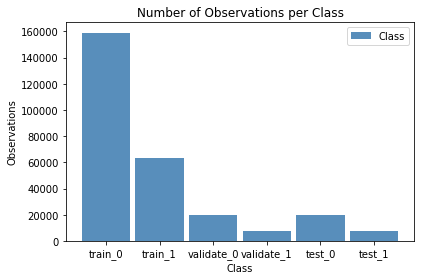

In [8]:
viz_data = []
for dir in dirs:
    for category in categories:
        files_num = len(os.listdir(dir + '/' + category))
        viz_data.append((str(dir.split('_')[-1]) + '_' + category, files_num))

xdata = [x[0] for x in viz_data]
ydata = [x[1] for x in viz_data]

def barchart(xdata, ydata, title, xlab, ylab, width, opacity, color):
    index = xdata
    fig, ax = plt.subplots()
    rects1 = plt.bar(index, ydata, width, alpha=opacity, color=color, label=xlab)
    plt.xlabel(xlab)
    plt.ylabel(ylab)
    plt.title(title)
    plt.legend()
    plt.tight_layout()
    plt.show()

barchart(xdata, ydata, title='Number of Observations per Class', xlab='Class', ylab='Observations', 
                                                                             width=0.9, opacity=0.9, color='steelblue')
